# Proyecto de reconocimiento de placas de Guatemala | Geordie Quiroa

## Nota: Encontré el TTF de las placas de Guatemala

El objetivo de este documento, es explicar el desarrollo y construcción de una arquitectura de red neuronal convolucional, que es capaz de identificar el número de placa de un vehículo, dada la imagen de un automóvil. 

Las etapas críticas desarrolladas para lograr el objetivo son:
* Detectar si existe una placa de vehículo en la imagen.
* Al detectar una placa, recortar la imagen para que ésta contenga únicamente la placa.
* Procesar la placa, segmentando caracter por caracter y llevar a cabo las transformaciones necesarias para poder ingresarlos a una CNN.
* Predecir la clase a la que corresponde cada caracter; mediante la implementación de la red neuronal convolucional desarrollada.
* Post-procesamiento para unificar el resultado.

[Paper de fundamento](https://arxiv.org/pdf/1709.08828.pdf)

In [2]:
# Sistema operativo
import sys
import os.path

# Manejo de arrays
import random
import numpy as np

# Machine Learning
from sklearn.model_selection import train_test_split
from keras.models import Sequential, Model
from keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout, BatchNormalization
from keras.models import load_model
import tensorflow as tf
from tensorflow.keras.utils import to_categorical

# Procesamiento de imágenes
import cv2 as cv
from skimage.io import imread
from skimage import io, img_as_ubyte 
from skimage.transform import rotate, AffineTransform, warp
from skimage.util import random_noise

# Visualización
import matplotlib.pyplot as plt

Using TensorFlow backend.


## Reconocimiento de placas
---
Para identificar un objeto de clase "placa" en una imagen, se utilizará la arquitectura de red neuronal convolucional que sugieren los autores de YOLO (You Only Look Once) v3, la cual consiste en una sola red neuronal convolucional que recibe como input una imagen completa, y la divide en regiones para predecir las coordenadas de rectangulos que contienen los objetos pertenecientes a las clases entrenadas; a través de 53 capas convolucionales, en este caso, la red es capaz de identificar objetos de tipo placa en las imágenes.

El entrenamiento de esta CNN, para identificar placas, se lleva a cabo sobre un dataset de imágenes con labels explícitos conteniendo el objeto a identificar, en este caso conteniendo la placa. El dataset de imágenes, requiere una transformación en el formato de la misma, y para ello hay que convertir las imágenes de .jpg | .png al formato de texto con anotaciones de Pascal VOC (Visual Object Classification) con el fin de que el framework Darknet, que implementa la arquitectura de Yolo, pueda llevar a cabo el entrenamiento.

La arquitectura de YOLO, consiste en entrenar una sola red neuronal con el objetivo de predecir las coordenadas del rectángulo que contiene el objeto, así como la clase del mismo.

Fuentes:
* [YOLO v3 paper](https://pjreddie.com/media/files/papers/YOLOv3.pdf)
* [YOLO project](https://pjreddie.com/darknet/yolo/)
* [Pascal VOC](https://pjreddie.com/media/files/VOC2012_doc.pdf)
* [YOLO Weights](https://www.kaggle.com/achrafkhazri/yolo-weights-for-licence-plate-detector#lapi.weights)

En resumen el funcionamiento de la red neuronal para la detección de placas es el siguiente:
* YOLO v3
    * Una sola red neuronal con 53 capas convolucionales para feature extracting por escala.
    * La red neuronal tiene 3 salidas:
        * Coordenadas del bounding box de la placa
            * Predice un cluster centroid con K-Means clustering, y predice la coordenada central utilizando la función sigmoide, y luego los offsets para las coordenadas, la función de costo es la sumatoria de la diferencia de los errores cuadrados entre cada coordenada.
        * Probabilidad de que el bounding box contenga un ground truth object
            * (Regresión logística), Treshold de 0.5.
        * Probabilidad de clase para el objeto; class prediction
            * no utilizan softmax, sino clasificadores logísticos independientes, ya que softmax implica la suposición de que un objeto es mutuamente excluyente entre las clases, lo que no considera el caso de clasificar una persona y una mujer.
* Anotaciones en formato Pascal VOC (Visual Object Classification)
    * Archivos de texto que permiten localizar el objeto a clasificar (ground truth object), utiliza la siguiente estructura por imagen: clase x y width height. 

In [2]:
# Configuración de la arquitectura YOLO v3
modelConfiguration = "darknet-yolov3.cfg"
#  Pesos ya entrenados para detectar placas.
modelWeights = "lapi.weights"
# Creación de la instancia de YOLO CNN con framework Darknet de OpenCV
net = cv.dnn.readNetFromDarknet(modelConfiguration, modelWeights)
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU) # Usa CPU en lugar de GPU

In [3]:
# YOLO output Layers en la arch
net.getUnconnectedOutLayers()
# Retorna los índices de los 3 outputs: coordenadas de los bounding box, objectness prob y predicción de clase (Placa)

array([[200],
       [227],
       [254]], dtype=int32)

# Detección de la placa
* * *
## Resumen del proceso para detectar una placa
* Lectura de la imagen del automóvil.
* Transformación de las dimensiones de la imagen a 416x416.
* Feed forward a la CNN de YOLO, utilizando como input la imagen transformada.
* Non-max suppression a los outputs de la CNN, para descartar bounding boxes traslapados.
* Identificar el rectángulo que contiene la placa en la imagen.
* Retorna las coordenadas del bounding box que contiene la placa.

## Selección del área que mejor contiene la placa utilizando la técnica de Non-Maximum Supression

Recibo las detecciones de regiones que contienen una placa; output de la CNN de YOLO, y su probabilidad de que pertenezca a la clase Placa. Extraigo el rectángulo con mayor nivel de confianza y lo agrego a otra lista de rectángulos finales. Calculo la intersección sobre la unión (IoU) del rectángulo extraído con los rectángulos restantes en las detecciones, si el IoU es mayor al treshold de NMS, remuevo dicho rectángulo de la lista de detecciones. Este proceso se repite hasta eliminar todas las detecciones, y se escoge el bounding box con mayor probabilidad de la lista final.

![Intersection over Union](IoU.png "IoU")
![Non Maximum Suppression](NMS.png "Non-Maximum Suppression")
[Fuente: Towards Data Science](https://towardsdatascience.com/non-maximum-suppression-nms-93ce178e177c)

In [4]:
def performNonMaxSuppression(frame, outs, confThreshold, nmsThreshold, classes):
    """ Selecciono el rectángulo con mayor probabilidad de clase.
    
    Remuevo los rectángulos traslapados, utilizando non-maximum suppression (obtengo la intersección de los traslapes)
    
    outs: array con todos los posibles rectángulos conteniendo la placa, resultados de la YOLO network.
    
    Retorno las coordenadas del rectangulo final conteniendo la placa.
    """
    
    frameHeight = frame.shape[0]
    frameWidth = frame.shape[1]
    
    classIds = []
    confidences = []
    boxes = []
    
    left = 0
    top = 0
    width = 0
    height = 0
    
    # Scaneo de todos los bounding boxes output de la Red YOLO
    for out in outs:
        #print("output layer shape : ", out.shape)
        
        # Filtro detecciones cuya probabilidad de contener una placa sea mayor al treshold
        for detection in out:
            #print(detection)
            scores = detection[5:]
            classId = np.argmax(scores)
            confidence = scores[classId]        
            if confidence > confThreshold:
                center_x = int(detection[0] * frameWidth)
                center_y = int(detection[1] * frameHeight)
                width = int(detection[2] * frameWidth)
                height = int(detection[3] * frameHeight)
                left = int(center_x - width / 2)
                top = int(center_y - height / 2)
                classIds.append(classId)
                confidences.append(float(confidence))
                # Agrego el bounding box cuya probabilidad de ser una placa mayor a treshold.
                boxes.append([left, top, width, height])

    # Llevo a cabo la técnica de Non-Maximum Suppresion
    indices = cv.dnn.NMSBoxes(boxes, confidences, confThreshold, nmsThreshold)
    #print(indices) #[[0]]
    for i in indices:
        i = i[0]
        box = boxes[i]
        left = box[0]
        top = box[1]
        width = box[2]
        height = box[3]
        # Dibujo el rectángulo final.
        drawRectangle(frame, classIds[i], confidences[i], left, top, left + width, top + height, classes)
    
    return [
        left,
        top,
        left + width, # Right
        top + height # Bottom
    ]

def getOutputLayers(net):
    """Recibe arquitectura de YOLO
    
    Retorna los 3 output layers de la arch.
    """
    # Nombres de las 3 output layers, Ej. layers de unconnected outputs
    return [net.getLayerNames()[i[0] - 1] for i in net.getUnconnectedOutLayers()]

def drawRectangle(frame, classId, conf, left, top, right, bottom, classes):
    """ Dibujo el rectángulo de la placa del carro. 
    
    Recibe el nombre de la clase (placa), treshold de prob. de confianza de ser una placa y coordenadas que contienen al objeto placa.
    
    Retorna la imagen con el rectángulo conteniendo a la placa, con label de Placa y la probabilidad de clase.
    """
    # Dibujo el rectángulo con las coordenadas ingresadas.
    cv.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 3)


    # Obtengo el nombre de la clase (Placa) y su probabilidad.
    label = '{}:{}%'.format(classes[classId], round(conf*100,2))

    #Display del label por encima del bounding box/
    labelSize, baseLine = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    top = max(top, labelSize[1]) # Coordenadas para posicionar el label en la esquina superior derecha.
    cv.rectangle(frame, (left, top - round(1.5*labelSize[1])), (left + round(1.5*labelSize[0]), top + baseLine), (0, 0, 255), cv.FILLED)
    cv.putText(frame, label, (left, top), cv.FONT_HERSHEY_SIMPLEX, 0.75, (0,0,0), 2)

In [46]:
def detectPlate(imagePath):
    """ Detecto el objeto de tipo placa.
    
    Proceso la imagen y la convierto a un tamaño fijo de 416x416 para ingresarla a la CNN de YOLO.
    
    Retorno las coordenadas de la placa.
    """
    # Parámetros de filtración
    confThreshold = 0.5  # threshold de confianza para probabilidad de clase
    nmsThreshold = 0.4  # IoU - Non-maximum suppression threshold, para reducir múltiples regiones a una sola.

    # Ancho y alto que soporta la CNN de YOLO
    inpWidth = 416
    inpHeight = 416
    
    # Imagen con la placa ubicada
    outputFile = imagePath[:-4]+'-with-plate.jpg'
    
    # Carga del nombre de las clases para la CNN - contiene solo la clase Placa
    classesFile = "classes.names"

    with open(classesFile, 'rt') as f:
        classes = f.read().rstrip('\n').split('\n')
        
    # Captura de la imagen
    cap = cv.VideoCapture(imagePath)

    # Lectura de la imagen
    hasFrame, frame = cap.read()
    
    # Visualización del vehículo a procesar.
    plt.title('Vehiculo a procesar:')
    plt.imshow(imread(imagePath))
    plt.axis('off')
    plt.show()
    
    print('\nTamaño de la imagen inicial: {}x{}, {} canales de color'.format(frame.shape[0], frame.shape[1], frame.shape[2]))
    
    # Transformacion de imagen input al tamaño aceptado por la YOLO Network
    blob = cv.dnn.blobFromImage(frame, 1/255, (inpWidth, inpHeight), [0,0,0], 1, crop=False)
    print('Convirtiendo imagen a tamaño fijo de {}x{}'.format(inpHeight,inpWidth))

    # Ingreso la imagen a las neuronas input de la CNN YOLO
    net.setInput(blob)
    
    # Llevo a cabo feed worward para obtener los resultados: coordenadas, objectness prob. and predicción de probabilidad de clase.
    print('\nIdentificando placa...')
    outs = net.forward(getOutputLayers(net))
    # Remuevo las bounding boxes traslapadas y obtengo la bounding box intersecto.
    left, top, right, bottom = performNonMaxSuppression(frame, outs, confThreshold, nmsThreshold, classes)
    
    if left != right: # Caso en el que la placa fue detectada
        print('\nPlaca identificada con coordenadas: \nleft: {}\ntop: {}\nright: {}\nbottom: {}'.format(left, top, right, bottom))

        # Guardo la imagen con la placa ubicada.
        cv.imwrite(outputFile, frame.astype(np.uint8))

        # Visualizacion de placa detectada.
        print('\nVisualización de placa detectada:')
        plt.figure(figsize=(20,20))
        processedImg = imread(outputFile)
        #plt.imshow(processedImg)
        plt.subplot(1,2, 1)
        plt.axis("off")
        plt.title('Auto con placa localizada')
        plt.imshow(processedImg)

        plt.subplot(1,2, 2)   
        plt.axis("off")
        plt.title('Placa aumentada')
        plt.imshow(processedImg[(top-20):bottom, left:right])
        plt.show()
    
    else:
        print('No fue posible identificar la placa.')
    
    return [
        left,
        top,
        right,
        bottom
    ]

In [399]:
image2scan = "./auto22.jpg"

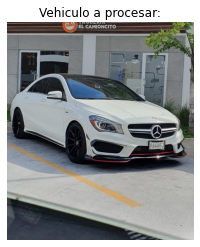


Tamaño de la imagen inicial: 1825x1564, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 1181
top: 993
right: 1320
bottom: 1068

Visualización de placa detectada:


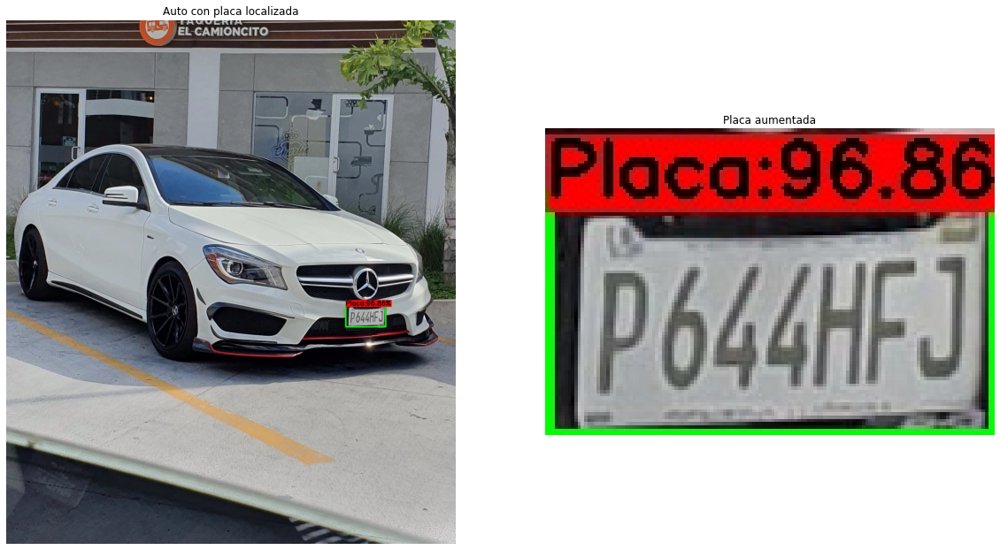

In [400]:
left, top, right, bottom = detectPlate(image2scan)

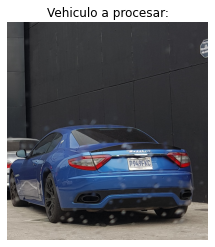


Tamaño de la imagen inicial: 1587x1465, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 882
top: 986
right: 1058
bottom: 1064

Visualización de placa detectada:


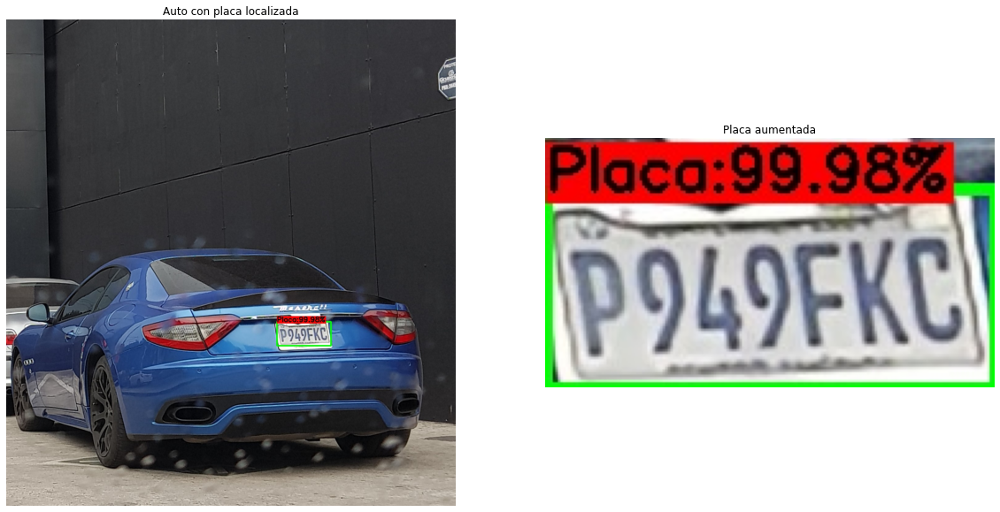

In [398]:
image2scan = "./auto11.jpg"
left, top, right, bottom = detectPlate(image2scan)

# Segmentación del contenido en la placa
---
Resumen del proceso para segmentar los caracteres/digitos en la placa:
* Recibe las coordenadas de la placa en la imagen.
* Optimización de contraste en la placa utilizando la técnica de ecualización del histograma.
* Transformación de 3 canales RGB, a 1 solo canal de color; escala de grises.
* Se lleva a cabo la segmentación de cada caracter/digito, utilizando tresholds.
    * Filtración por tresholds del contenido de la imagen (Otsu's).
    * Obtención de contornos.
    * Evaluación del área que abarca cada contorno, para determinar si es un caracter/digito o no en base al área del contorno.
    * Ordenamiento, de derecha a izquierda, de los caracteres identificados.
    * Identificación de las coordenadas del bounding box que contiene cada caracter.
    * Transformación de bounding boxes rectangulares a cuadrados de 28x28.
* Retorna cada digito/caracter en la placa en un tamaño fijo.

Para segmentar los caracteres de la placa, se utilizó el método de proyección de histograma del pixel, para encontrar la concentración vertical y horizontal de pixeles, y separarlos cuando no se cumpla el treshold. Una vez se segmentan los caracteres, se detectan los contornos y se procede a identificar el rectángulo que contiene el objeto contornado, para introducirlos posteriormente a la red neuronal convolucional desarrollada.

![Proyección de histograma del pixel](./charsProjections.png "Histograma de pixeles")

### Método de Otsu
Este método retrona un solo treshold de intensidad que divide el histograma de intensidad, con el objetivo de aumentar la varianza entre clases. De esta manera, es posible distingir entre los objetos de fondo y al frente.

![Método de Otsu](./otsu.png "Método de Otsu")

[Fuente: Research Gate](https://www.researchgate.net/figure/Character-extraction-using-the-horizontal-and-vertical-projection-method_fig7_3428145)
, [Scipy Lectures - Otsu](https://scipy-lectures.org/packages/scikit-image/auto_examples/plot_threshold.html)

In [8]:
def square(img):
    """Transformación de una imagen rectangular a una cuadrada.
    
    Conversión de dimensiones de la imagen que contiene el caracter/digito con Altura <> Ancho a Altura = Ancho. 
    
    Retorna un numpy array con la imagen transformada. 
    """

    # Imagen output
    squaredImage = img

    # Altura y ancho original
    h = img.shape[0]
    w = img.shape[1]

    # En caso de que sea más alta que ancha
    if h > w:
        diff = h-w
        if diff % 2 == 0:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(h, diff//2))
            x2 = x1
        else:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(h, diff//2))
            x2 = np.zeros(shape=(h, (diff//2)+1))

        # Uno los pixeles de relleno con la img original
        squaredImage = np.concatenate((x1, img, x2), axis=1)

    # En caso de que se más ancha que alta
    if h < w:
        diff = w-h
        if diff % 2 == 0:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(diff//2, w))
            x2 = x1
        else:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(diff//2, w))
            x2 = np.zeros(shape=((diff//2)+1, w))

        # Uno los pixeles de relleno con la img original
        squaredImage = np.concatenate((x1, img, x2), axis=0)

    return squaredImage

def autoCanny(image, sigma=0.33):
    """Aplicación del método Canny
    
    Retorna los contornos del caracter/digito
    """
    # compute the median of the single channel pixel intensities
    v = np.median(image)
 
    # apply automatic Canny edge detection using the computed median
    lower = int(max(0, (1.0 - sigma) * v))
    upper = int(min(255, (1.0 + sigma) * v))
    edged = cv.Canny(image, lower, upper)
 
    # return the edged image
    return edged

def plateSegmentation(imgFilePath, top, bottom, left, right, withOptimization = True):
    """ Identifica los digitos/caracteres contenidos en la placa.
    
    Recibe la imagen, y las coordenadas del bounding box conteniendo la placa.
    
    Lleva a cabo la segmentación de cada caracter/digito.
    
    Retorna un arreglo conteniendo los pixeles de cada caracter, ordenados de izq - der.
    """

    img = cv.imread(imgFilePath)
    
    # Selección del segmento que contiene a la placa
    img = img[top:bottom, left:right]
    
    if withOptimization:
        # Optimización de contraste a través de ecualización de histograma en cada canal de color.
        R, G, B = cv.split(img)
        r = cv.equalizeHist(R)
        g = cv.equalizeHist(G)
        b = cv.equalizeHist(B)
        img = cv.merge((r,g,b))
    
    # Transformación de 3 canales de color a 1.
    imgray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # Dimensiones de la placa
    height = img.shape[0]
    width = img.shape[1]
    
    # Área a escanear
    area = height * width

    # Tresholds respecto al área de cada caracter detectado.
    scale1 = 0.035
    scale2 = 0.1
    area_condition1 = area * scale1
    area_condition2 = area * scale2
    
    # global thresholding
    ret1,th1 = cv.threshold(imgray,127,255,cv.THRESH_BINARY)

    # Otsu's thresholding
    ret2,th2 = cv.threshold(imgray,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)

    # Otsu's thresholding after Gaussian filtering
    blur = cv.GaussianBlur(imgray,(5,5),0)
    ret3,th3 = cv.threshold(blur,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
    
    # Detección de contornos utilizando los tresholdings.
    contours, hierarchy = cv.findContours(th3, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

    # Ordenamiento de contornos de Izq - Der.
    contours = sorted(contours, key=lambda ctr: cv.boundingRect(ctr)[0])
    
    # Bounding boxes conteniendo los caracteres
    cropped = []
    areas = []
    
    # Calculo del área de cada contorno
    for cnt in contours:
        (x,y,w,h) = cv.boundingRect(cnt)

        if (w * h > area_condition1 and w * h < area_condition2 and w/h > 0.3 and h/w > 0.3):
            areas.append(cv.contourArea(cnt))
            #print(cv.contourArea(cnt))
    
    # Treshold para descartar objetos contornados con menor área.
    areaTreshold = np.max(areas)*1/3
    
    #print('Area treshold: ', areaTreshold)
    
    # Filtración de los contornos, para extraer únicamente los contornos de digitos y letras.
    for cnt in contours:
        (x,y,w,h) = cv.boundingRect(cnt)

        if (w * h > area_condition1 and w * h < area_condition2 and w/h > 0.3 and h/w > 0.3):
            #if cv.contourArea(cnt) > areaMean:
            cv.drawContours(img, [cnt], 0, (0, 255, 0), 3)
            #plt.imshow(img)
            #plt.show()
            if cv.contourArea(cnt) > areaTreshold:
                cv.rectangle(img, (x,y), (x+w,y+h), (255, 0, 0), 2)
                c = th2[y:y+h,x:x+w]
                c = np.array(c)
                c = cv.bitwise_not(c)
                c = square(c)
                c = cv.resize(c,(28,28), interpolation = cv.INTER_AREA)
                cropped.append(c)
    
    # -------- Esto era para detectar contornos con canny, pero no dio buenos resultados
    #img_area = img.shape[0]*img.shape[1]
    #gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
    #thresh_inv = cv.adaptiveThreshold(gray,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY_INV,39,1)
    #edges = autoCanny(thresh_inv)
    #contours, _ = cv.findContours(edges.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    
    #cropped = []
    #for i, ctr in enumerate(contours):
    #    (x, y, w, h) = cv.boundingRect(ctr)
    #    roi_area = w*h
    #    non_max_sup = roi_area/img_area

        #if((non_max_sup >= 0.055) and (non_max_sup < 0.09)):
         #   if ((h>1.2*w) and (3*w>=h)):
          #      cv.rectangle(img,(x,y),( x + w, y + h ),(90,0,255),2)
           #     char = edges[y:y+h,x:x+w]
            #    char = np.array(char)
                #char = cv.bitwise_not(char)
             #   char = square(char)
              #  char = cv.resize(char,(28,28), interpolation = cv.INTER_AREA)
               # cropped.append(char)
    
    #print('Cropped promedio de area ', np.mean(cropped))
    print('\nSegmentando Placa...')
    cv.imwrite('detection.png', img)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    return cropped


Segmentando Placa...


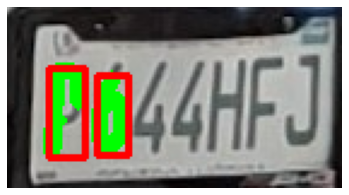

In [9]:
# Sin ecualización del histograma para mejorar contraste.
cropped = plateSegmentation(image2scan, top, bottom, left, right, withOptimization=False)


Segmentando Placa...


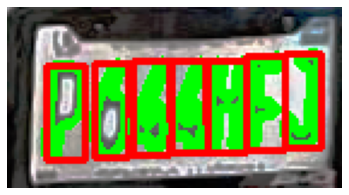

In [401]:
cropped = plateSegmentation(image2scan, top, bottom, left, right, withOptimization=True)

In [402]:
len(cropped)

7

Extracción de caracteres:


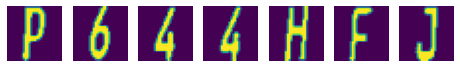

In [403]:
print('Extracción de caracteres:')
plt.figure(figsize=(8,8))
i = 1
for crop in cropped:
    plt.subplot(1,7, i)
    plt.axis("off")    
    plt.imshow(crop)
    i+=1

plt.show()


# Entrenamiento de la red neuronal convolucional para detectar caracteres y digitos en la placa
---

Para entrenar la red neuronal convolucional, se utilizará un dataset de caracteres con un tamaño fijo de 28x28, para que ésta aprenda a identficar cada uno de los digitos y letras contenidos en una placa vehicular.

Las imágenes de las placas, pueden variar en tamaño, y tienen los 3 canales de color RGB. Sin embargo, para entrenar la red neuronal convolucional, se estará procesando las imágenes en escala de grises, ya que el color de una placa no incide en la naturaleza del caracter o digito a clasificar.

Resumen del desarrollo de la red neuronal convolucional:
* Carga y preprocesamiento de las imágenes de entrenamiento y prueba.
* Desarrollo de la arquitectura de la CNN.
* Validación cruzada del modelo.
* Visualización de métricas de precisión y costo.
* Optimización del modelo.

## Carga y pre-procesamiento de imágenes del dataset

En esta etapa se cargan todas las imágenes para cada caracter y digito, se les aplica una transformación de 3 canales de color, a uno solo; escala de grises. En total, son 36 caracteres; conteniendo las letras mayúsculas del abecedario, y los digitos del 0-9.

In [12]:
def loadDataset(path):
    """ Carga y transformación de imágenes del dataset.
    """
    dirs = [
        d for d in os.listdir(path) if os.path.isdir(os.path.join(path,d))
    ]
    
    classes = [0,1,2,3,4,5,6,7,8,9,'A', 'B', 'C', 'D', 'E', 'F', 'G','H','I', 'J', 'K','L','M','N','O','P','Q','R','S','T','U', 'V','W','X','Y','Z']
    classes = [str(val) for val in classes]
    
    classesEncoding = [ i for i in range(len(classes))]
    
    # For converting a letter into its encoding number Ex. A = class 11
    classesDict = dict(zip(classes, classesEncoding))
    
    labels = []
    images = []
    
    for d in dirs:
        print('Cargando y transfromando imágenes de clase -{}- ...'.format(d))
        label_dir = os.path.join(path, d)
        file_names = [
            os.path.join(label_dir, f) 
            for f in os.listdir(label_dir)
            #if f.endswith('.ppm')
        ]
        
        for image in file_names:
            img = cv.imread(image)
            imgGray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
            #thresh_inv = cv.adaptiveThreshold(imgGray,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY_INV,39,1)
            #edges = autoCanny(thresh_inv, sigma=0.001)
            #images.append(edges)
            images.append(imgGray)
            labels.append(classesDict[d])
    print('Se cargaron todas las imágenes.')
    return np.array(images), np.array(labels)

In [13]:
images, labels = loadDataset('./dataset/')

Cargando y transfromando imágenes de clase -0- ...
Cargando y transfromando imágenes de clase -1- ...
Cargando y transfromando imágenes de clase -2- ...
Cargando y transfromando imágenes de clase -3- ...
Cargando y transfromando imágenes de clase -4- ...
Cargando y transfromando imágenes de clase -5- ...
Cargando y transfromando imágenes de clase -6- ...
Cargando y transfromando imágenes de clase -7- ...
Cargando y transfromando imágenes de clase -8- ...
Cargando y transfromando imágenes de clase -9- ...
Cargando y transfromando imágenes de clase -A- ...
Cargando y transfromando imágenes de clase -B- ...
Cargando y transfromando imágenes de clase -C- ...
Cargando y transfromando imágenes de clase -D- ...
Cargando y transfromando imágenes de clase -E- ...
Cargando y transfromando imágenes de clase -F- ...
Cargando y transfromando imágenes de clase -G- ...
Cargando y transfromando imágenes de clase -H- ...
Cargando y transfromando imágenes de clase -I- ...
Cargando y transfromando imágen

In [14]:
# 36,576 digits and characters images with a size of 28x28
images.shape 

(73152, 28, 28)

In [15]:
labels.shape

(73152,)

### Este dataset contiene letras de distintas tipografías, ajenas a las que utilizan las placas de Guatemala

Clases de digitos y caracteres


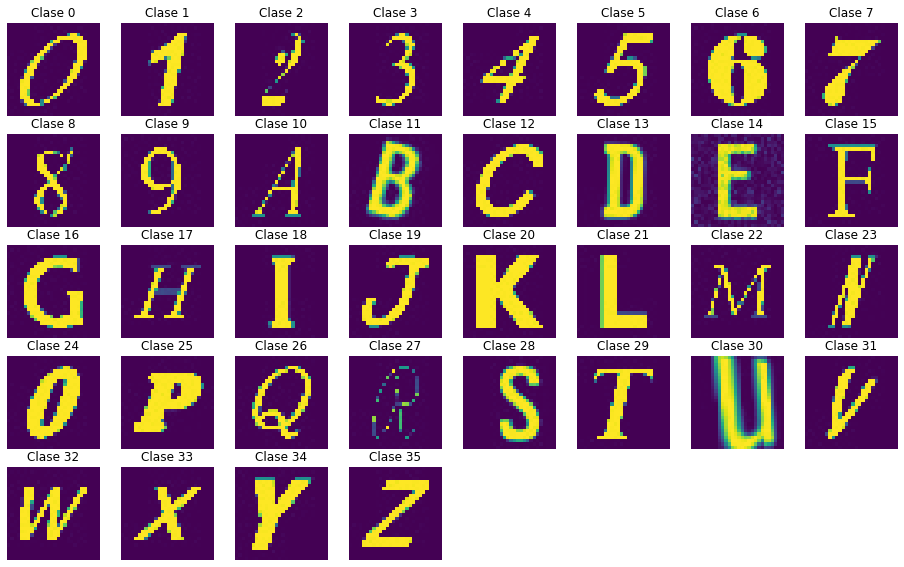

In [16]:
print('Clases de digitos y caracteres')
unique_labels = set(labels)
plt.figure(figsize=(16,16))
i = 1
for label in unique_labels:
    tmpImage = images[list(labels).index(label) + random.randint(1,1000)+ 1010]
    plt.subplot(8,8, i)
    plt.axis("off")
    plt.title("Clase {}".format(label, list(labels).count(label)))
    i+=1
    plt.imshow(tmpImage)

plt.show()

## One hot encoding

In [17]:
totalClasses = np.unique(labels).shape[0]
totalClasses

36

In [18]:
labels = to_categorical(labels, totalClasses)

In [19]:
labels.shape

(73152, 36)

## Shuffle de datos, y separación en train y test (80,20)

In [20]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.20, random_state=161)

## Normalización de los pixeles

In [21]:
# Normalizing data between [0,1]
X_train = X_train.astype("float32") / 255.0
X_test = X_test.astype("float32") / 255.0

In [22]:
X_train.shape, X_test.shape

((58521, 28, 28), (14631, 28, 28))

## Reshape de los valores independientes para contener un solo canal de color

In [23]:
trainSize, height, width = X_train.shape
trainSize

58521

In [24]:
testSize, height, width = X_test.shape
testSize

14631

In [25]:
# Utilizamos un solo canal de color. BGR2GRAY
X_train = X_train.reshape(trainSize, height, width, 1)
X_test = X_test.reshape(testSize, height, width, 1)


# Construcción de Red Neuronal Convolucional

## Función de visualización para las métricas de precisión del modelo 

In [26]:
def plot_hist(model_history):
    fix,axs=plt.subplots(2,1,figsize=(20,15))
    ax1 = axs[0]
    ax1.plot(model_history.history['accuracy'])
    ax1.plot(model_history.history['val_accuracy'],c='g')
    ax1.set_title('Model accuracy',fontsize=16)
    ax1.set_ylabel('Accuracy',fontsize=8)
    ax1.set_xlabel('Epoch',fontsize=8)
    ax1.grid(alpha=0.3)
    ax1.legend(['Train', 'Test'], loc='upper left')


    # # summarize history for loss
    ax2 = axs[1]
    ax2.plot(model_history.history['loss'],c='r')
    ax2.plot(model_history.history['val_loss'],c='orange')
    ax2.set_title('Model loss',fontsize=16)
    ax2.set_ylabel('Accuracy',fontsize=8)
    ax2.set_xlabel('Epoch',fontsize=8)
    ax2.grid(alpha=0.3)
    ax2.legend(['train', 'test'], loc='upper right')
    plt.show()


# Arquitectura final de CNN para clasificar caracteres de placas
---
Luego de un proceso iterativo de prueba y error:
* Agregando/quitando capas convolucionales.
* Tuneando hipérparámetros.
* Kernel y pool size.
* Número de filtros.
* Porcentaje de dropout.
* Optimizador
* Batch size
* Epochs

Se encontró la arquitectura que mejores resultados entregó a lo largo del entrenamiento y validación de prueba. Sin embargo, las métricas de precisión evidencian overfitting, pues el costo del entrenamiento es más bajo que el de prueba, y la precisión es más alta;  lo que se traduce a mayor varianza en datos de prueba a falta de bias. Este tema será tratado más adelante.

In [76]:
cnn_model = Sequential(name='Identificación del contenido de la placa - Proyecto Final Elements')

#convlolutional layers
cnn_model.add(Conv2D(32, kernel_size=(5, 5), activation='relu', padding='same', input_shape=(28,28,1), use_bias=True))
cnn_model.add(MaxPooling2D(pool_size=(2,2)))

cnn_model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same', use_bias=True))
cnn_model.add(BatchNormalization())
cnn_model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', use_bias=True))
cnn_model.add(BatchNormalization())
cnn_model.add(MaxPooling2D(pool_size=(2,2)))

# dense layers
cnn_model.add(Flatten())
cnn_model.add(Dropout(0.5))
#cnn_model.add(Dense(1572, activation='relu', use_bias=True)) # Clasifica mal 0-> 2,7 -> X | CrossVal 97.97
cnn_model.add(Dense(761, activation='relu', use_bias=True))
cnn_model.add(Dense(totalClasses, activation='softmax'))

# Compile the model
cnn_model.compile(optimizer='Adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

cnn_model.summary()

Model: "Identificación del contenido de la placa - Proyecto Final Elements"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_13 (Conv2D)           (None, 28, 28, 32)        832       
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 14, 14, 64)        18496     
_________________________________________________________________
batch_normalization_9 (Batch (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 12, 12, 64)        36928     
_________________________________________________________________
batch_normalization_10 (Batc (None, 12, 12, 64)        256       
_________________________________________________________________


In [77]:
cnn_model_history = cnn_model.fit(
                        X_train,
                        y_train,
                        batch_size = 64,
                        epochs = 15,
                        validation_split = 0.2,
                        #validation_data=(X_test, y_test),
                        shuffle=False, # La data se mezclo en la carga del dataset
                        verbose=1,
                        use_multiprocessing=True
)

Train on 46816 samples, validate on 11705 samples
Epoch 1/15
46816/46816 [==============================] - 85s 2ms/step - loss: 0.4209 - accuracy: 0.8916 - val_loss: 0.1320 - val_accuracy: 0.9622
Epoch 2/15
46816/46816 [==============================] - 82s 2ms/step - loss: 0.1336 - accuracy: 0.9604 - val_loss: 0.0987 - val_accuracy: 0.9720
Epoch 3/15
46816/46816 [==============================] - 85s 2ms/step - loss: 0.0978 - accuracy: 0.9700 - val_loss: 0.0932 - val_accuracy: 0.9718
Epoch 4/15
46816/46816 [==============================] - 84s 2ms/step - loss: 0.0796 - accuracy: 0.9745 - val_loss: 0.0944 - val_accuracy: 0.9726
Epoch 5/15
46816/46816 [==============================] - 83s 2ms/step - loss: 0.0687 - accuracy: 0.9779 - val_loss: 0.0961 - val_accuracy: 0.9740
Epoch 6/15
46816/46816 [==============================] - 85s 2ms/step - loss: 0.0640 - accuracy: 0.9804 - val_loss: 0.0997 - val_accuracy: 0.9746
Epoch 7/15
46816/46816 [==============================] - 86s 2ms/st

In [78]:
# Cross Validation Metrics
test_loss, test_acc = cnn_model.evaluate(X_test, y_test)

print('\nTest accuracy:', test_acc)
print('Test loss:    ', test_loss)

14631/14631 [==============================] - 6s 410us/step

Test accuracy: 0.9817510843276978
Test loss:     0.06948859657783542


In [84]:
#cnn_model.save('./detectorDePlacasFinal')
#cnn_model = load_model('./detectorDePlacasFinal')

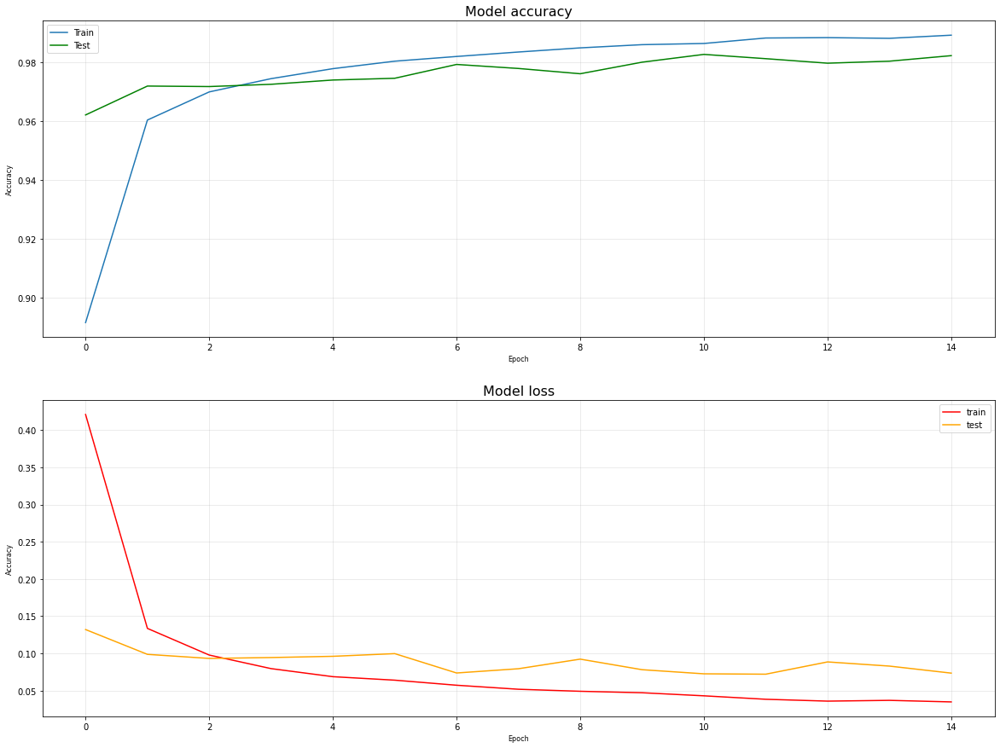

In [79]:
plot_hist(cnn_model_history)

# Mejorando capacidad de generalización agregando Bias
---
Para evaluar la mejora en la capacidad de generalización del modelo, es decir, reducir la Varianza a través de un aumento en el Bias, se desarrollarán dos modelos que se basan en el modelo funcional desarrollado, manejando las siguientes variaciones:
* Aumento de bias a través de dropouts de nodos en las capas.
* Aumento de bias a través de la implementación de funciones de penalización Ridge L2 y Lasso L1 (elastic net).

![Ridge y Lasso](./RidgeLasso.png "L1 y L2")

### Penalización Lasso L1
Introduce bias minimizando la ecuación de la sumatoria de los errores cuadrados y la sumatoria del valor absoluto de los coeficientes por el valor de penalización.
* Se recomienda utilizarla cuando no todas las features son significativas; las descarta debido a que el mínimo en la fx de valor absoluto es muy cercano a 0.
![lasso](./lasso.png "L1")

### Penalización Ridge L2
Introduce bias minimizando la ecuación de la sumatoria de los errores cuadrados y la sumatoria de los coeficientes cuadrados por el valor de penalización.
* Se recomienda utilizarla cuando la mayoría de las features son significativas.

![ridge](./ridge.png "L2")

### Aumento de bias a través de dropout de neuronas

In [194]:
# Con dropout
cnn_model_generalizer = Sequential(name='Identificación del contenido de la placa - Mejor Generalización - Proyecto Final Elements')

#convlolutional layers
cnn_model_generalizer.add(Conv2D(32, kernel_size=(5, 5), activation='relu', padding='same', input_shape=(28,28,1), use_bias=True))
cnn_model_generalizer.add(MaxPooling2D(pool_size=(2,2)))
cnn_model_generalizer.add(Dropout(0.25))

cnn_model_generalizer.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same', use_bias=True))
cnn_model_generalizer.add(BatchNormalization())
cnn_model_generalizer.add(Conv2D(64, kernel_size=(3, 3), activation='relu', use_bias=True))
cnn_model_generalizer.add(BatchNormalization())
cnn_model_generalizer.add(MaxPooling2D(pool_size=(2,2)))
cnn_model_generalizer.add(Dropout(0.25))

# dense layers
cnn_model_generalizer.add(Flatten())
cnn_model_generalizer.add(Dropout(0.5))
cnn_model_generalizer.add(Dense(1572, activation='relu', use_bias=True))
cnn_model_generalizer.add(Dense(totalClasses, activation='softmax'))

# Compile the model
cnn_model_generalizer.compile(optimizer='Adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

cnn_model_generalizer.summary()

Model: "Identificación del contenido de la placa - Mejor Generalización - Proyecto Final Elements"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_52 (Conv2D)           (None, 28, 28, 32)        832       
_________________________________________________________________
max_pooling2d_35 (MaxPooling (None, 14, 14, 32)        0         
_________________________________________________________________
dropout_23 (Dropout)         (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_53 (Conv2D)           (None, 14, 14, 64)        18496     
_________________________________________________________________
batch_normalization_35 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_54 (Conv2D)           (None, 12, 12, 64)        36928     
___________________________________________

In [195]:
cnn_model_generalizer_history = cnn_model_generalizer.fit(
                        X_train,
                        y_train,
                        batch_size = 64,
                        epochs = 15,
                        validation_split = 0.2,
                        #validation_data=(X_test, y_test),
                        shuffle=False, # La data se mezclo en la carga del dataset
                        verbose=1,
                        use_multiprocessing=True
)

Train on 46816 samples, validate on 11705 samples
Epoch 1/15
46816/46816 [==============================] - 109s 2ms/step - loss: 0.5549 - accuracy: 0.8606 - val_loss: 0.1536 - val_accuracy: 0.9540
Epoch 2/15
46816/46816 [==============================] - 104s 2ms/step - loss: 0.1771 - accuracy: 0.9470 - val_loss: 0.1243 - val_accuracy: 0.9613
Epoch 3/15
46816/46816 [==============================] - 102s 2ms/step - loss: 0.1356 - accuracy: 0.9585 - val_loss: 0.1074 - val_accuracy: 0.9697
Epoch 4/15
46816/46816 [==============================] - 102s 2ms/step - loss: 0.1126 - accuracy: 0.9654 - val_loss: 0.0904 - val_accuracy: 0.9748
Epoch 5/15
46816/46816 [==============================] - 104s 2ms/step - loss: 0.0984 - accuracy: 0.9695 - val_loss: 0.0930 - val_accuracy: 0.9735
Epoch 6/15
46816/46816 [==============================] - 102s 2ms/step - loss: 0.0931 - accuracy: 0.9717 - val_loss: 0.0961 - val_accuracy: 0.9732
Epoch 7/15
46816/46816 [==============================] - 101s

In [196]:
# Cross Validation Metrics
test_loss, test_acc = cnn_model_generalizer.evaluate(X_test, y_test)

print('\nTest accuracy:', test_acc)
print('Test loss:    ', test_loss)

14631/14631 [==============================] - 7s 461us/step

Test accuracy: 0.9820244908332825
Test loss:     0.07421997952358086


In [198]:
#cnn_model_generalizer.save('./detectorDePlacasFinalDropout')

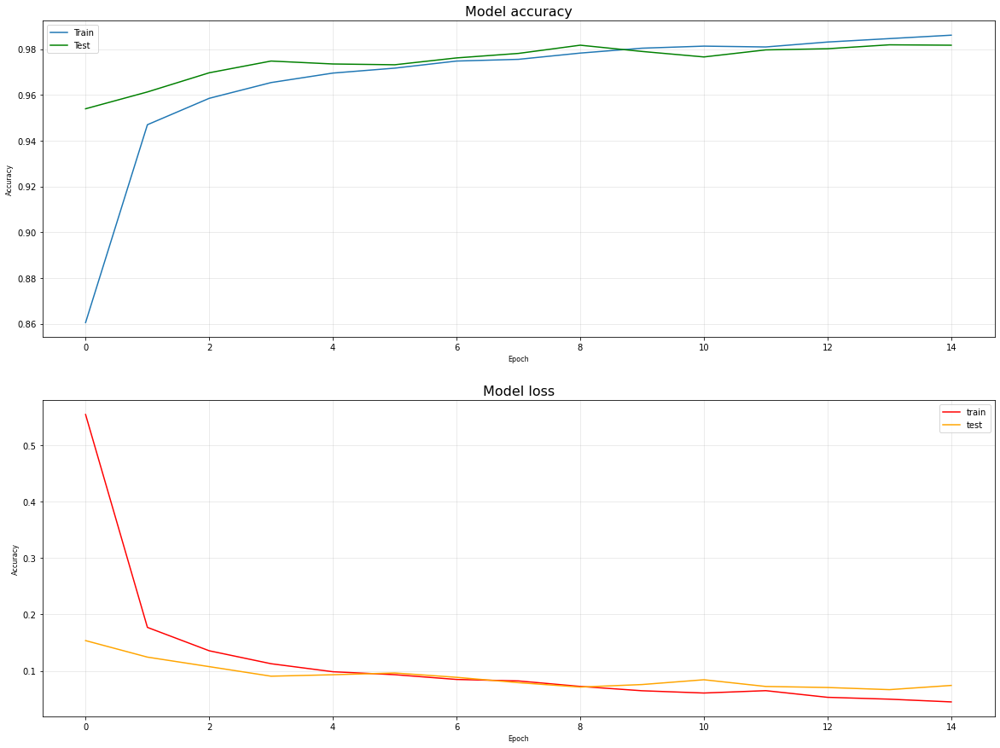

In [197]:
plot_hist(cnn_model_generalizer_history)

## Aumento del bias a través de penalización elastic net L1 y L2

In [184]:
from keras.regularizers import l1_l2
# Elastic net regularizations> utiliza Ridge y Lasso penalty functions
# con L1,L2 = 0.01, CrossVal: 93.15. Confunde M con X.
# con L2, L3 = 0.001 CrossVal: 96.06 Confunde W con M.
# con L2 = 0.01 y L1 = 0.001 CrossVal: 95.56 Confunde 6 con 9, 0 con U.
# con Dropout y L1,L2 = 0.001 CrissVal 95.91

L1 = 0.001 #0.01 = no mejoro. # No todas las features son significativas.
L2 = 0.001

# Con regularizador
cnn_model_generalizer = Sequential(name='Identificación del contenido de la placa - Mejor Generalización - Proyecto Final Elements')

#convlolutional layers
cnn_model_generalizer.add(Conv2D(32, kernel_size=(5, 5), activation='relu', padding='same', input_shape=(28,28,1), use_bias=True, kernel_regularizer=l1_l2(l1=L1, l2=L2)))
cnn_model_generalizer.add(MaxPooling2D(pool_size=(2,2)))
#cnn_model_generalizer.add(Dropout(0.25))

cnn_model_generalizer.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same', use_bias=True, kernel_regularizer=l1_l2(l1=L1, l2=L2)))
cnn_model_generalizer.add(BatchNormalization())
cnn_model_generalizer.add(Conv2D(64, kernel_size=(3, 3), activation='relu', use_bias=True, kernel_regularizer=l1_l2(l1=L1, l2=L2)))
cnn_model_generalizer.add(BatchNormalization())
cnn_model_generalizer.add(MaxPooling2D(pool_size=(2,2)))
#cnn_model_generalizer.add(Dropout(0.25))

# dense layers
cnn_model_generalizer.add(Flatten())
cnn_model_generalizer.add(Dropout(0.5))
#cnn_model_generalizer.add(Dense(1572, activation='relu', use_bias=True, kernel_regularizer=l1_l2(l1=0.01, l2=0.01)))
cnn_model_generalizer.add(Dense(761, activation='relu', use_bias=True, kernel_regularizer=l1_l2(l1=L1, l2=L2)))
cnn_model_generalizer.add(Dense(totalClasses, activation='softmax'))

# Compile the model
cnn_model_generalizer.compile(optimizer='Adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

cnn_model_generalizer.summary()

Model: "Identificación del contenido de la placa - Mejor Generalización - Proyecto Final Elements"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_46 (Conv2D)           (None, 28, 28, 32)        832       
_________________________________________________________________
max_pooling2d_31 (MaxPooling (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_47 (Conv2D)           (None, 14, 14, 64)        18496     
_________________________________________________________________
batch_normalization_31 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_48 (Conv2D)           (None, 12, 12, 64)        36928     
_________________________________________________________________
batch_normalization_32 (Batc (None, 12, 12, 64)        256       
___________________________________________

In [185]:
cnn_model_generalizer_history = cnn_model_generalizer.fit(
                        X_train,
                        y_train,
                        batch_size = 64,
                        epochs = 20,
                        validation_split = 0.2,
                        #validation_data=(X_test, y_test),
                        shuffle=False, # La data se mezclo en la carga del dataset
                        verbose=1,
                        use_multiprocessing=True
)

Train on 46816 samples, validate on 11705 samples
Epoch 1/20
46816/46816 [==============================] - 89s 2ms/step - loss: 7.7706 - accuracy: 0.8654 - val_loss: 2.4859 - val_accuracy: 0.9277
Epoch 2/20
46816/46816 [==============================] - 90s 2ms/step - loss: 1.7982 - accuracy: 0.9270 - val_loss: 1.4763 - val_accuracy: 0.9461
Epoch 3/20
46816/46816 [==============================] - 85s 2ms/step - loss: 1.3985 - accuracy: 0.9378 - val_loss: 1.3859 - val_accuracy: 0.9426
Epoch 4/20
46816/46816 [==============================] - 85s 2ms/step - loss: 1.2922 - accuracy: 0.9421 - val_loss: 1.2715 - val_accuracy: 0.9466
Epoch 5/20
46816/46816 [==============================] - 88s 2ms/step - loss: 1.2056 - accuracy: 0.9459 - val_loss: 1.2273 - val_accuracy: 0.9430
Epoch 6/20
46816/46816 [==============================] - 90s 2ms/step - loss: 1.1308 - accuracy: 0.9480 - val_loss: 1.1484 - val_accuracy: 0.9502
Epoch 7/20
46816/46816 [==============================] - 89s 2ms/st

In [368]:
#cnn_model_generalizer.save('./detectorDePlacasFinalRegularizado')

In [369]:
# Cross Validation Metrics
test_loss, test_acc = cnn_model_generalizer.evaluate(X_test, y_test)

print('\nTest accuracy:', test_acc)
print('Test loss:    ', test_loss)

14631/14631 [==============================] - 8s 567us/step

Test accuracy: 0.9608365893363953
Test loss:     0.8548074645554813


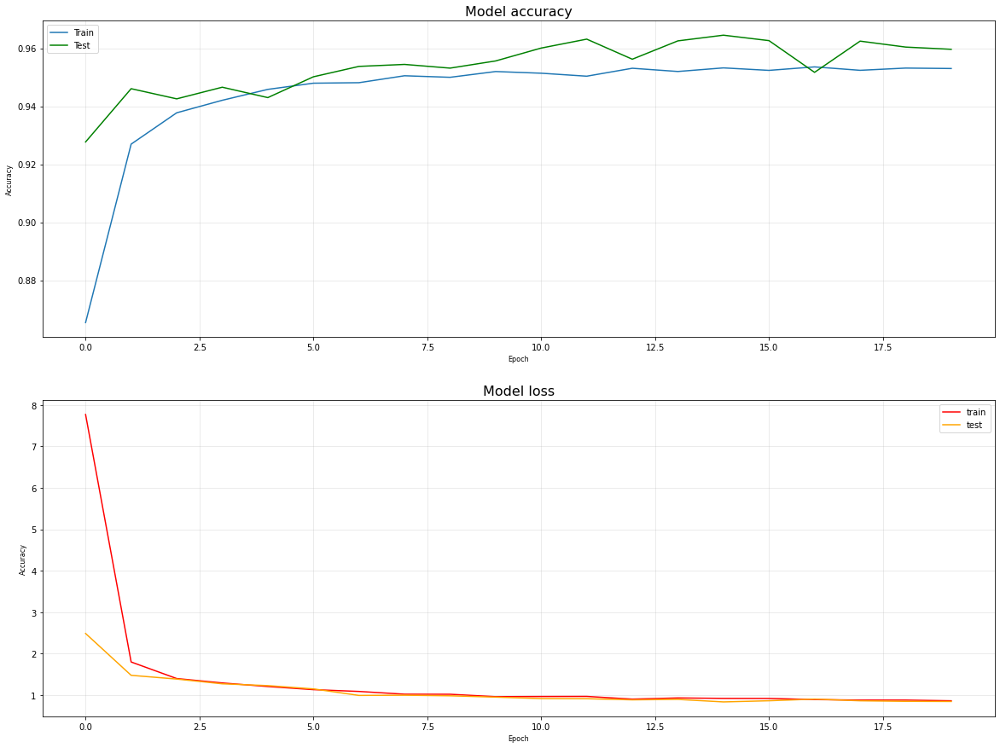

In [187]:
# Con regularización en todas las capas menos en la salida.
plot_hist(cnn_model_generalizer_history)

### Aplicando regularización elastic net solo en últimas 2 capas.

In [229]:
# Elastic net regularizations> utiliza Ridge y Lasso penalty functions

# Sin activity regulariztion CrosVal: 96.94

L1 = 0.001 #0.01 = no mejoro. # No todas las features son significativas.
L2 = 0.001

# Con regularizador
cnn_model_generalizer = Sequential(name='Identificación del contenido de la placa - Mejor Generalización - Proyecto Final Elements')

#convlolutional layers
cnn_model_generalizer.add(Conv2D(32, kernel_size=(5, 5), activation='relu', padding='same', input_shape=(28,28,1), use_bias=True))
cnn_model_generalizer.add(MaxPooling2D(pool_size=(2,2)))
#cnn_model_generalizer.add(Dropout(0.25))

cnn_model_generalizer.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same', use_bias=True))
cnn_model_generalizer.add(BatchNormalization())
cnn_model_generalizer.add(Conv2D(64, kernel_size=(3, 3), activation='relu', use_bias=True))
cnn_model_generalizer.add(BatchNormalization())
cnn_model_generalizer.add(MaxPooling2D(pool_size=(2,2)))
#cnn_model_generalizer.add(Dropout(0.25))

# dense layers
cnn_model_generalizer.add(Flatten())
cnn_model_generalizer.add(Dropout(0.5))
#cnn_model_generalizer.add(Dense(1572, activation='relu', use_bias=True, kernel_regularizer=l1_l2(l1=0.01, l2=0.01)))
cnn_model_generalizer.add(Dense(761, activation='relu', use_bias=True, kernel_regularizer=l1_l2(l1=L1, l2=L2)))
cnn_model_generalizer.add(Dense(totalClasses, activation='softmax', activity_regularizer=l1_l2(l1=L1, l2=L2)))

# Compile the model
cnn_model_generalizer.compile(optimizer='Adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

cnn_model_generalizer.summary()

Model: "Identificación del contenido de la placa - Mejor Generalización - Proyecto Final Elements"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_55 (Conv2D)           (None, 28, 28, 32)        832       
_________________________________________________________________
max_pooling2d_37 (MaxPooling (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_56 (Conv2D)           (None, 14, 14, 64)        18496     
_________________________________________________________________
batch_normalization_37 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_57 (Conv2D)           (None, 12, 12, 64)        36928     
_________________________________________________________________
batch_normalization_38 (Batc (None, 12, 12, 64)        256       
___________________________________________

In [230]:
cnn_model_generalizer_history = cnn_model_generalizer.fit(
                        X_train,
                        y_train,
                        batch_size = 64,
                        epochs = 15,
                        validation_split = 0.2,
                        #validation_data=(X_test, y_test),
                        shuffle=False, # La data se mezclo en la carga del dataset
                        verbose=1,
                        use_multiprocessing=True
)

Train on 46816 samples, validate on 11705 samples
Epoch 1/15
46816/46816 [==============================] - 91s 2ms/step - loss: 6.7713 - accuracy: 0.8672 - val_loss: 2.1594 - val_accuracy: 0.9313
Epoch 2/15
46816/46816 [==============================] - 89s 2ms/step - loss: 1.6482 - accuracy: 0.9363 - val_loss: 1.3090 - val_accuracy: 0.9528
Epoch 3/15
46816/46816 [==============================] - 91s 2ms/step - loss: 1.2643 - accuracy: 0.9503 - val_loss: 1.2005 - val_accuracy: 0.9601
Epoch 4/15
46816/46816 [==============================] - 91s 2ms/step - loss: 1.1436 - accuracy: 0.9565 - val_loss: 1.0313 - val_accuracy: 0.9647
Epoch 5/15
46816/46816 [==============================] - 89s 2ms/step - loss: 1.0513 - accuracy: 0.9610 - val_loss: 1.0247 - val_accuracy: 0.9674
Epoch 6/15
46816/46816 [==============================] - 87s 2ms/step - loss: 1.0016 - accuracy: 0.9635 - val_loss: 0.9260 - val_accuracy: 0.9677
Epoch 7/15
46816/46816 [==============================] - 89s 2ms/st

In [231]:
# Cross Validation Metrics
test_loss, test_acc = cnn_model_generalizer.evaluate(X_test, y_test)

print('\nTest accuracy:', test_acc)
print('Test loss:    ', test_loss)

14631/14631 [==============================] - 8s 562us/step

Test accuracy: 0.9719772934913635
Test loss:     0.702100781494575


In [233]:
#cnn_model_generalizer.save('./detectorDePlacasFinalRegularizado2capas')

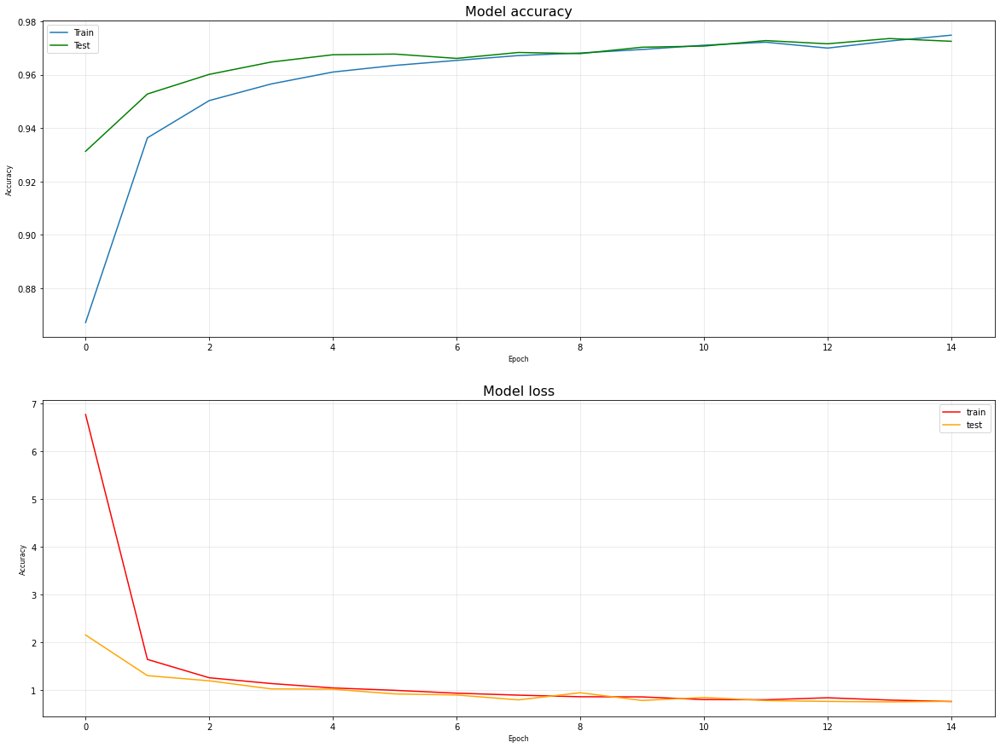

In [370]:
# Con regularización solo en la capa intermedia y activity regularization en la salida.
plot_hist(cnn_model_generalizer_history)

# Modelo para caracteres contornados

In [505]:
cnn_model_canny = Sequential(name='Elements Project - Car plate identification w/ edges')

#convlolutional layers
cnn_model_canny.add(Conv2D(32, kernel_size=(5, 5), activation='relu', padding='same', input_shape=(28,28,1), use_bias=True))
cnn_model_canny.add(BatchNormalization())
cnn_model_canny.add(Conv2D(32, kernel_size=(3, 3), activation='relu', use_bias=True))
cnn_model_canny.add(MaxPooling2D(pool_size=(2,2)))

cnn_model_canny.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same', use_bias=True))
cnn_model_canny.add(BatchNormalization())
cnn_model_canny.add(MaxPooling2D(pool_size=(2,2)))

# dense layers
cnn_model_canny.add(Flatten())
cnn_model_canny.add(Dropout(0.5))
cnn_model_canny.add(Dense(512, activation='relu', use_bias=True))
cnn_model_canny.add(Dense(totalClasses, activation='softmax'))

# Compile the model
cnn_model_canny.compile(optimizer='Adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

cnn_model_canny.summary()

Model: "Elements Project - Car plate identification w/ edges"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_19 (Conv2D)           (None, 28, 28, 32)        832       
_________________________________________________________________
batch_normalization_13 (Batc (None, 28, 28, 32)        128       
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 26, 26, 32)        9248      
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 13, 13, 64)        18496     
_________________________________________________________________
batch_normalization_14 (Batc (None, 13, 13, 64)        256       
_________________________________________________________________
max_pooling2d_

In [506]:
model_history = cnn_model_canny.fit(
                        X_train,
                        y_train,
                        batch_size = 64,
                        epochs = 15,
                        validation_split = 0.2,
                        #validation_data=(X_test, y_test),
                        shuffle=False, # # La data se mezclo en la carga del dataset
                        verbose=1,
                        use_multiprocessing=True
)

Train on 46816 samples, validate on 11705 samples
Epoch 1/15
46816/46816 [==============================] - 93s 2ms/step - loss: 0.5661 - accuracy: 0.8509 - val_loss: 0.1797 - val_accuracy: 0.9489
Epoch 2/15
46816/46816 [==============================] - 98s 2ms/step - loss: 0.1867 - accuracy: 0.9454 - val_loss: 0.1609 - val_accuracy: 0.9580
Epoch 3/15
46816/46816 [==============================] - 90s 2ms/step - loss: 0.1343 - accuracy: 0.9596 - val_loss: 0.1283 - val_accuracy: 0.9641
Epoch 4/15
46816/46816 [==============================] - 97s 2ms/step - loss: 0.1172 - accuracy: 0.9638 - val_loss: 0.1524 - val_accuracy: 0.9597
Epoch 5/15
46816/46816 [==============================] - 103s 2ms/step - loss: 0.0996 - accuracy: 0.9695 - val_loss: 0.1412 - val_accuracy: 0.9623
Epoch 6/15
46816/46816 [==============================] - 98s 2ms/step - loss: 0.0866 - accuracy: 0.9731 - val_loss: 0.1284 - val_accuracy: 0.9653
Epoch 7/15
46816/46816 [==============================] - 93s 2ms/s

In [507]:
# Cross Validation Metrics
test_loss, test_acc = cnn_model_canny.evaluate(X_test, y_test)

print('\nTest accuracy:', test_acc)
print('Test loss:    ', test_loss)

14631/14631 [==============================] - 6s 413us/step

Test accuracy: 0.9716355800628662
Test loss:     0.13409031600206794


In [ ]:
#cnn_model_canny.save('./finalPlateClassifierCanny')

# Selección de la mejor arquitectura desarrollada para la Red Neuronal Convolucional
---
Tomando en consideración las métricas de precisión, el costo que presentaron para los datos de prueba y entrenamiento, y la validación en imágenes de vehículos de verdad. Se concluye que el mejor modelo convolucional es el Regularizado con Elastic Net (penalización L1 y L2) en cada una de las capas convolucionales e intermedias, ya que este modelo, a pesar de tener el nivel de precisión con validación cruzada más bajo (96.08%) y costo mínimo de (0.85), resuelve el asunto de overfiting que presentaba el modelo inicial con precisión de (98%), de igual manera, logró predecir de manera satisfactoria, las distintas imágenes a predecir que se probaron con dicho modelo. 

La arquitectura ilustrada de este modelo convolucional es la siguiente:

![Arquitectura final](./arquitecturaFinal.png "Arquitectura CNN Final")

# Corrección de letras mal predichas utilizando un font de las placas de Guate
---
Al evaluar el modelo final sobre placas reales, fue posible observar que confundía letras similares como W con V, N con M, 0 con D entre otros, y al revisar el dataset que se había utilizado para el entrenamiento, fue posible notar que las letras y digitos tenían estilos ligeramente diferentes a los caracteres que se encuentran en las placas. 

Por lo que se procedió a buscar una tipografía, en formato TTF, similar al de las placas de Guatemala, para poder crear un Dataset nuevo utilizando dichas letras y digitos para agregarlas al dataset previo.

Luego de buscar tipografías de autos, se encontró una que es practicamente la que se utiilza en las placas de Guatemala: [Fuente de la tipografía de placas](https://www.1001fonts.com/car-go-plain-3-1-demo-font.html#waterfall)

Se agregaron 1016 imágenes por cada caracter de esta tipografía, llevando a cabo las siguientes técnicas de data augmentation sobre cada caracter:
* Rotación aleatoria de hasta 15 grados, en sentido del reloj y anti reloj.
* Traslación aleatoria.
* Transformación aleatoria de perspectiva.


In [234]:
from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont

def makeCharImgs(font_path, output_height):
    """ Convierto el caracter TTF en un numpy array
    
    Retorno un array 28x28 con cada caracter del font.
    """
    
    # Estos son los chars que se utilizaran del font
    DIGITS = "0123456789"
    LETTERS = "ABCDEFGHIJKLMNOPQRSTUVWXYZ"
    CHARS = LETTERS + DIGITS
    
    font_size = output_height * 4

    font = ImageFont.truetype(font_path, font_size)

    height = max(font.getsize(c)[1] for c in CHARS)
    
    i=0
    totalChars = len(CHARS)
    
    chars = []
    
    for c in CHARS:
        width = font.getsize(c)[0]
        
        # Creo un cuadrado vacio para dibujar el caracter.
        im = Image.new("RGBA", (height, height), (0, 0, 0))

        draw = ImageDraw.Draw(im)
        
        # Dibujo el caracter en el centro,
        draw.text(((height - width)/2, -7), c, (255, 255, 255), font=font)
        #im = im.resize((output_height, output_height), Image.ANTIALIAS)
        im = cv.resize(np.array(im), (28,28), interpolation = cv.INTER_AREA)
        #plt.subplot(1, totalChars, i+1)
        #plt.axis("off")
        #plt.imshow(im)
        #plt.subplots_adjust(wspace=0.5)
        #i+=1
        chars.append(im)
        #plt.show()
        #print( c, np.array(im)[:, :, 0].astype(np.float32) / 255.)
        #plt.imshow(np.array(im)[:, :, 0].astype(np.float32) / 255.)
    
    return chars

In [235]:
chars = makeCharImgs('./fonts/cargoplain.ttf', 28) # 28x28

Caracteres en la tipografía descargada


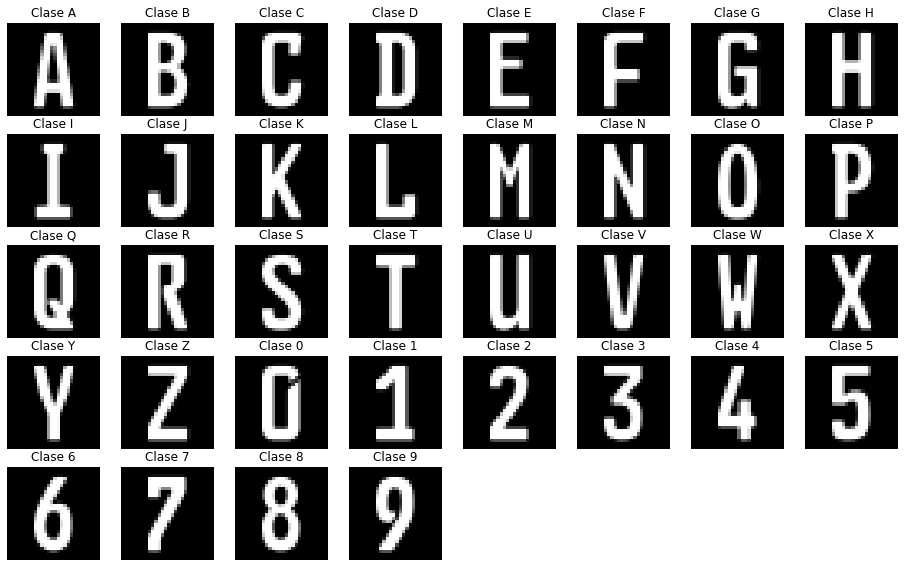

In [252]:
print('Caracteres en la tipografía descargada')
plt.figure(figsize=(16,16))
i = 1
DIGITS = "0123456789"
LETTERS = "ABCDEFGHIJKLMNOPQRSTUVWXYZ"
CHARS = LETTERS + DIGITS
for char in chars:
    tmpImage = char
    plt.subplot(8,8, i)
    plt.axis("off")
    plt.title("Clase {}".format(CHARS[i-1]))
    i+=1
    plt.imshow(tmpImage)

plt.show()

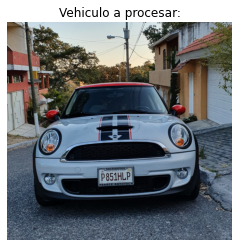


Tamaño de la imagen inicial: 2124x2193, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 898
top: 1420
right: 1223
bottom: 1579

Visualización de placa detectada:


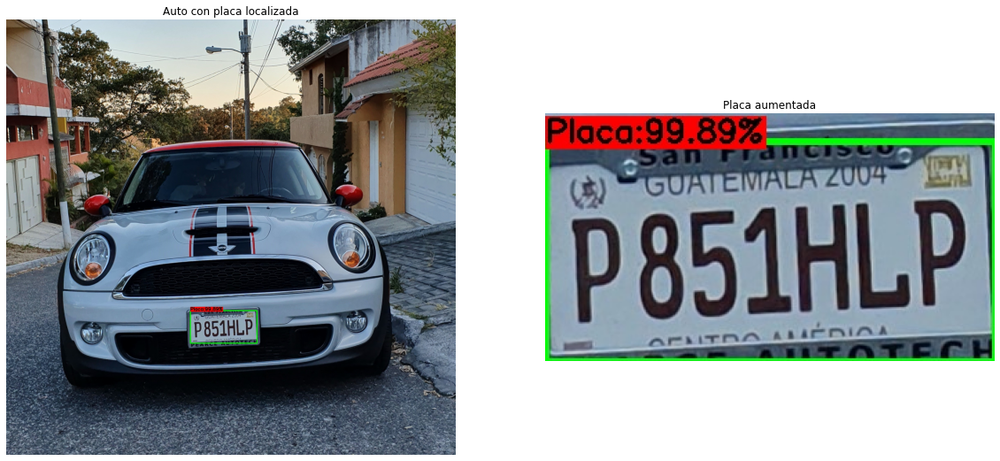

In [247]:
image2scan = 'auto17.jpg'
left, top, right, bottom = detectPlate(image2scan)


Segmentando Placa...


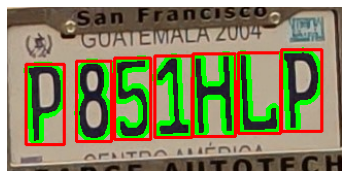

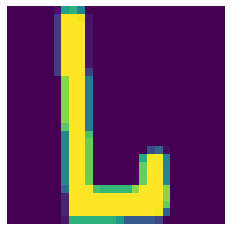

In [254]:
cropped = plateSegmentation(image2scan, top, bottom, left, right, withOptimization=False)
plt.axis('off')
plt.imshow(cropped[5])
plt.show()

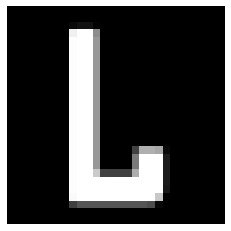

In [253]:
plt.imshow(chars[11])
plt.axis('off')
plt.show()

In [255]:
def saveChar(outputFile, charArray):
    """Guardo el array de pixeles del caracter en una imagen."""
    cv.imwrite(outputFile, charArray.astype(np.uint8))

In [256]:
# Voy a guardar cada caracter de formato TTF a una imagen.
i=0
for char in chars:
    outputFile = "{}_{}.jpg".format(CHARS[i],1017)
    saveChar('./fontImages/{}/'.format(CHARS[i])+outputFile, char)
    i+=1

In [325]:
# Transformaciones para data augmentation
def anticlockwiseRotation(image):
    angle= random.randint(0,15)
    return rotate(image, angle)

def clockwiseRotation(image):
    angle= random.randint(0,15)
    return rotate(image, -angle)

def addNoise(image):
    return random_noise(image)

def warpShift(image): 
    leftOrRight = [1,-1]
    transform = AffineTransform(translation=(random.randint(0,7)*random.choice(leftOrRight),random.randint(0,3)*random.choice(leftOrRight)))  #chose x,y values according to your convinience
    warp_image = warp(image, transform, mode="wrap")
    return warp_image

def warpPerspective(image):
    dst = np.float32([
        [3, 5],
        [24, 0],
        [24, 27],
        [3, 23]])
    
    dst2 = np.float32([
        [0, 0],
        [28, 0],
        [28, 28],
        [0, 28]])
    
    leftOrRight=[1,-1]
    angle= random.randint(0,8)
    image = rotate(image, random.choice(leftOrRight) * angle)
    
    M = cv.getPerspectiveTransform(dst, dst2)
    warped = cv.warpPerspective(image, M, (28, 28))
    # return the warped image
    return warped

In [258]:
def generateAugmentedImages(char, augmented_path, images_to_generate, path_origin_image, base=1017):
    transformations = {
        'rotate anticlockwise': anticlockwiseRotation,
        'rotate clockwise': clockwiseRotation,
        'warp shift': warpShift,
        'adding noise': addNoise,
        'warp perspective':warpPerspective
    }
    print('Generando imágenes para el char: {}...'.format(char))
    i = 1 # contador de imagenes
    #base = 1017
    #base = 1017

    while i <= images_to_generate:
        image = path_origin_image.format(char, char, base)
        original_image = io.imread(image)
        n = 0 # cantidad de transformaciones hechas
        transformation_count = len(transformations)

        while n <= transformation_count:
            key = random.choice(list(transformations)) # seleccionar una transformacion aleatoria.
            transformed_image = transformations[key](original_image)
            n += 1

        new_image_path = augmented_path.format(char, char, i+base)
        transformed_image = img_as_ubyte(transformed_image)  #Convert an image to unsigned byte format, with values in [0, 255].
        transformed_image=cv.cvtColor(transformed_image, cv.COLOR_BGR2RGB) #convert image to RGB before saving it
        cv.imwrite(new_image_path, transformed_image) # save transformed image to path
        i += 1
    

In [259]:
pathOriginImage="./fontImages/{}/{}_{}.jpg" # path de la imagen fuente a generar
augmentedPath="./dataset/{}/{}_{}.jpg"
images2generate = 1016

In [262]:
# Probando el metodo de aumentar imagenes antes de implementarlo en el dataset original.
generateAugmentedImages('A',"./fontImages/{}/{}_{}.jpg", images2generate, pathOriginImage, base=1017)

Generando imágenes para el char: A...


In [263]:
pathOriginImage="./fontImages/{}/{}_{}.jpg" # path to store aumented images
augmentedPath="./dataset/{}/{}_{}.jpg"
base = 1017
images2generate = 1016

for char in CHARS:
    generateAugmentedImages(char,augmentedPath, images2generate, pathOriginImage, base=1017)

Generando imágenes para el char: A...
Generando imágenes para el char: B...
Generando imágenes para el char: C...
Generando imágenes para el char: D...
Generando imágenes para el char: E...
Generando imágenes para el char: F...
Generando imágenes para el char: G...
Generando imágenes para el char: H...
Generando imágenes para el char: I...
Generando imágenes para el char: J...
Generando imágenes para el char: K...
Generando imágenes para el char: L...
Generando imágenes para el char: M...
Generando imágenes para el char: N...
Generando imágenes para el char: O...
Generando imágenes para el char: P...
Generando imágenes para el char: Q...
Generando imágenes para el char: R...
Generando imágenes para el char: S...
Generando imágenes para el char: T...
Generando imágenes para el char: U...
Generando imágenes para el char: V...
Generando imágenes para el char: W...
Generando imágenes para el char: X...
Generando imágenes para el char: Y...
Generando imágenes para el char: Z...
Generando im

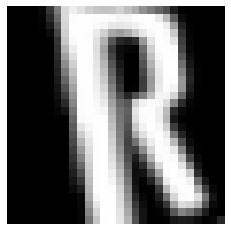

In [337]:
plt.imshow(warpPerspective(chars[17]))
plt.axis('off')
plt.show()

# Construcción de métodos para llevar a cabo la prueba del modelo de clasificación

In [264]:
# Diccionario para decoficar la clase que predice el modelo
classes = [0,1,2,3,4,5,6,7,8,9,'A', 'B', 'C', 'D', 'E', 'F', 'G','H','I', 'J', 'K','L','M','N','O','P','Q','R','S','T','U', 'V','W','X','Y','Z']
classes = [str(val) for val in classes]

classesEncoding = [ i for i in range(len(classes))]

dictDecoding = dict(zip(classesEncoding, classes))

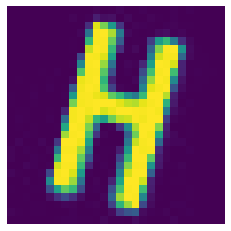

In [305]:
char2test = X_test[6]
plt.imshow(char2test.reshape(28,28))
plt.axis('off')
plt.show()

In [306]:
predClass = cnn_model.predict_classes((char2test).reshape(1,28,28,1))[0]
dictDecoding[predClass]

'H'

In [308]:
def predictPlate(content, dictDecoding, model):
    """ Recibe los caracteres detectados en la placa.
    
    Predice la clase uno por uno y la decodifica del one hot encoding.
    
    Retorna la concatenación de los caracteres predichos.
    """
    plate = []
    for char in content:
        predClass = model.predict_classes((char/255.0).reshape(1,28,28,1))[0]
        plate.append(dictDecoding[predClass])

    return ''.join(plate)

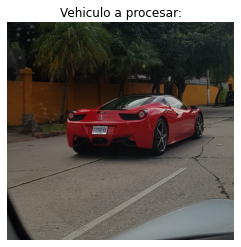


Tamaño de la imagen inicial: 1844x1925, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 711
top: 871
right: 864
bottom: 942

Visualización de placa detectada:


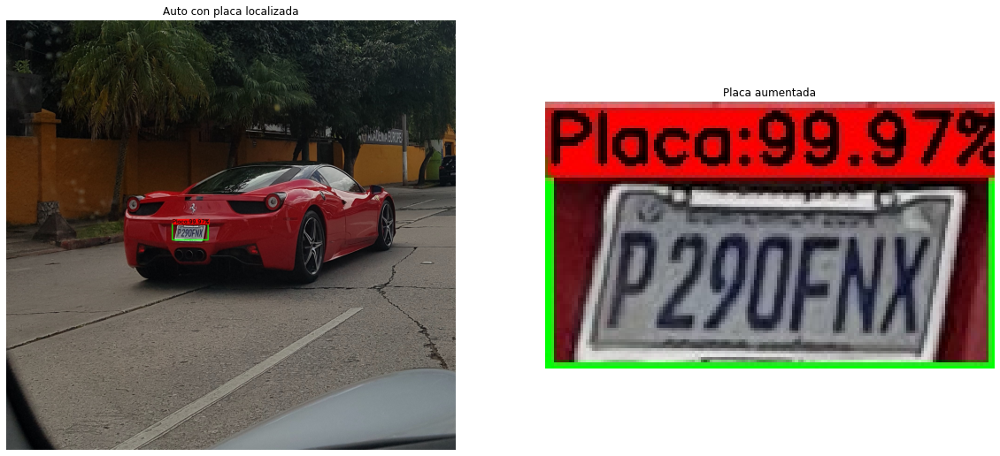

In [431]:
image2scan = "./auto18.jpg"
left, top, right, bottom = detectPlate(image2scan)


Segmentando Placa...


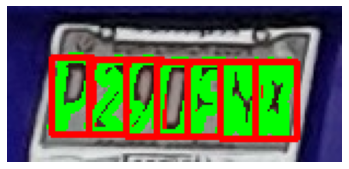

Extracción de caracteres:


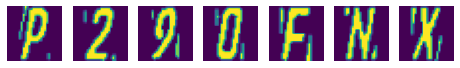

In [428]:
cropped = plateSegmentation(image2scan, top, bottom, left, right, withOptimization=False)
print('Extracción de caracteres:')
plt.figure(figsize=(8,8))
i = 1
for crop in cropped:
    plt.subplot(1,7, i)
    plt.axis("off")    
    plt.imshow(crop)
    i+=1

plt.show()

In [316]:
plate = predictPlate(cropped, dictDecoding, model)
plate

'P29UFNX'

In [366]:
plate = predictPlate(cropped, dictDecoding, model) # confunde G -> 6, W -> V, P -> R
plate

'R29UFNX'

In [364]:
plate = predictPlate(cropped, dictDecoding, cnn_model)
plate

'P290FNX'

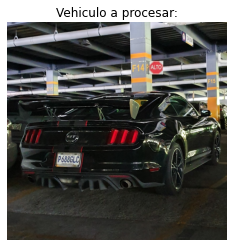


Tamaño de la imagen inicial: 1644x1658, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 372
top: 991
right: 554
bottom: 1081

Visualización de placa detectada:


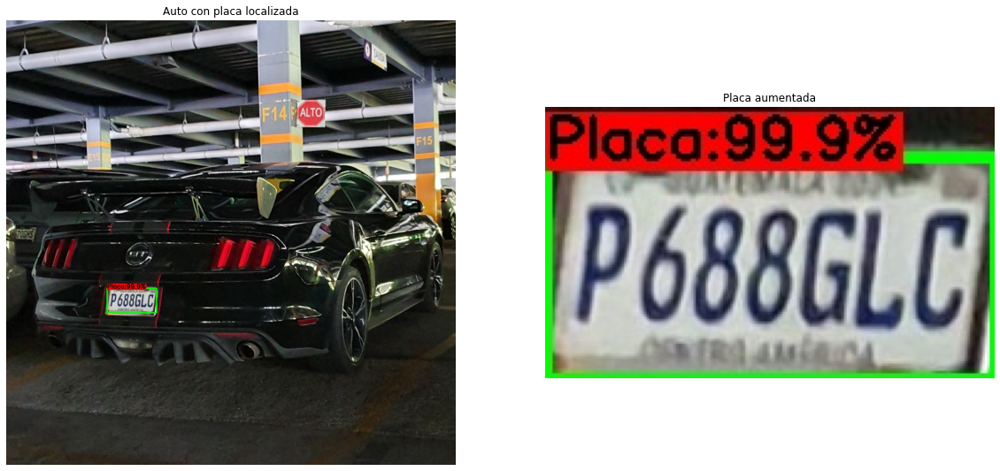

In [429]:
image2scan = "./auto3.jpg"
left, top, right, bottom = detectPlate(image2scan)


Segmentando Placa...


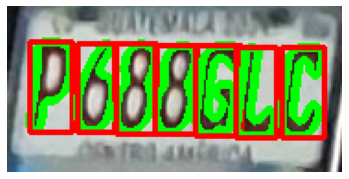

Extracción de caracteres:


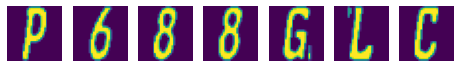

In [430]:
cropped = plateSegmentation(image2scan, top, bottom, left, right, withOptimization=False)
print('Extracción de caracteres:')
plt.figure(figsize=(8,8))
i = 1
for crop in cropped:
    plt.subplot(1,7, i)
    plt.axis("off")    
    plt.imshow(crop)
    i+=1

plt.show()

In [322]:
def writeClassPrediction(imagePath, label, top, bottom, left, right):
    """Recibo el path de la imagen con la ubicación de la placa y la predicción.
    
    Retorno la imagen con la placa localizada y la predicción correspondiente.
    """
    cap = cv.VideoCapture(imagePath)
    outputFile = imagePath[:-4]+'-final.jpg'
    hasFrame, frame = cap.read()
    
    # Draw a bounding box.
    cv.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 3)

    # Get the label for the class name and its confidence
    label = ' Placa: {}'.format(label)

    #Display the label at the top of the bounding box
    labelSize, baseLine = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    top = max(top-10, labelSize[1]) # coordinates for positioning the label.
    cv.rectangle(frame, (left, top - round(1.5*labelSize[1])), (left + round(1.5*labelSize[0]), top + baseLine), (0, 255, 0), cv.FILLED)
    cv.putText(frame, label, (left, top), cv.FONT_HERSHEY_SIMPLEX, 0.75, (0,0,0), 2)
    
    print('Prediciendo placa...')
    cv.imwrite(outputFile, frame.astype(np.uint8))
    frame = imread(outputFile)
    plt.figure(figsize=(16,16))
    plt.imshow(frame)
    plt.axis("off")
    plt.show()
    
    return frame

Prediciendo placa...


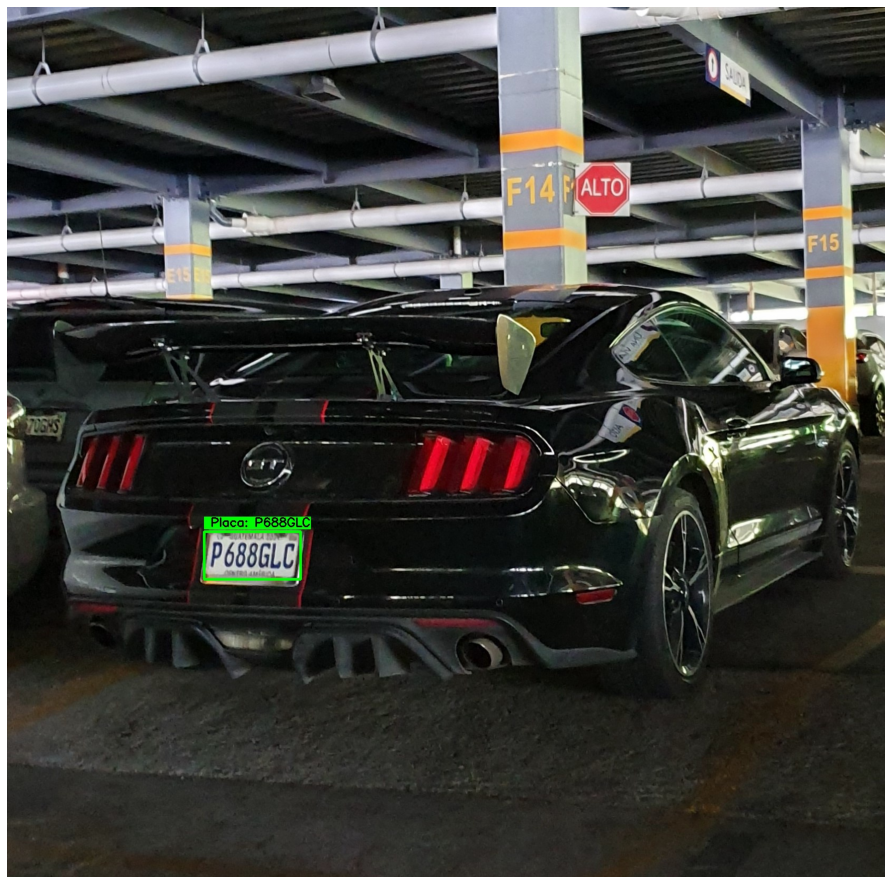

array([[[145, 150, 180],
        [142, 147, 177],
        [140, 145, 175],
        ...,
        [ 40,  33,  14],
        [ 43,  36,  17],
        [ 46,  39,  20]],

       [[145, 150, 180],
        [142, 147, 177],
        [141, 146, 176],
        ...,
        [ 74,  68,  46],
        [ 86,  80,  58],
        [ 89,  83,  61]],

       [[146, 151, 181],
        [145, 150, 180],
        [145, 150, 180],
        ...,
        [111, 105,  81],
        [119, 113,  89],
        [121, 115,  91]],

       ...,

       [[ 49,  46,  37],
        [ 48,  45,  36],
        [ 47,  44,  35],
        ...,
        [ 32,  32,  24],
        [ 29,  28,  23],
        [ 29,  28,  23]],

       [[ 49,  49,  39],
        [ 48,  48,  38],
        [ 47,  47,  37],
        ...,
        [ 32,  32,  24],
        [ 33,  32,  27],
        [ 33,  32,  27]],

       [[ 50,  50,  40],
        [ 49,  49,  39],
        [ 48,  48,  38],
        ...,
        [ 33,  33,  25],
        [ 36,  35,  30],
        [ 36,  35,  30]]

In [323]:
writeClassPrediction(image2scan, plate, top, bottom, left, right)

# Unificación de todas las etapas para llevar a cabo la predicción de placas
---

In [386]:
# Modelo de CNN con overfitting
cnn_model = load_model('./detectorDePlacasFinal')

In [3]:
# Modelo de CNN con regularización de Elastic Net en todas las capas.
cnn_model_elastic = load_model('./detectorDePlacasFinalRegularizado')

In [311]:
# Modelo de CNN con dropouts
cnn_model_dropout = load_model('./detectorDePlacasDropout')

### Código de cada una de las etapas anteriores

In [ ]:
# Configuración de la arquitectura YOLO v3
modelConfiguration = "darknet-yolov3.cfg"
#  Pesos ya entrenados para detectar placas.
modelWeights = "lapi.weights"
# Creación de la instancia de YOLO CNN con framework Darknet de OpenCV
net = cv.dnn.readNetFromDarknet(modelConfiguration, modelWeights)
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU) # Usa CPU en lugar de GPU

def performNonMaxSuppression(frame, outs, confThreshold, nmsThreshold, classes):
    """ Selecciono el rectángulo con mayor probabilidad de clase.
    
    Remuevo los rectángulos traslapados, utilizando non-maximum suppression (obtengo la intersección de los traslapes)
    
    outs: array con todos los posibles rectángulos conteniendo la placa, resultados de la YOLO network.
    
    Retorno las coordenadas del rectangulo final conteniendo la placa.
    """
    
    frameHeight = frame.shape[0]
    frameWidth = frame.shape[1]
    
    classIds = []
    confidences = []
    boxes = []
    
    left = 0
    top = 0
    width = 0
    height = 0
    
    # Scaneo de todos los bounding boxes output de la Red YOLO
    for out in outs:
        #print("output layer shape : ", out.shape)
        
        # Filtro detecciones cuya probabilidad de contener una placa sea mayor al treshold
        for detection in out:
            #print(detection)
            scores = detection[5:]
            classId = np.argmax(scores)
            confidence = scores[classId]        
            if confidence > confThreshold:
                center_x = int(detection[0] * frameWidth)
                center_y = int(detection[1] * frameHeight)
                width = int(detection[2] * frameWidth)
                height = int(detection[3] * frameHeight)
                left = int(center_x - width / 2)
                top = int(center_y - height / 2)
                classIds.append(classId)
                confidences.append(float(confidence))
                # Agrego el bounding box cuya probabilidad de ser una placa mayor a treshold.
                boxes.append([left, top, width, height])

    # Llevo a cabo la técnica de Non-Maximum Suppresion
    indices = cv.dnn.NMSBoxes(boxes, confidences, confThreshold, nmsThreshold)
    #print(indices) #[[0]]
    for i in indices:
        i = i[0]
        box = boxes[i]
        left = box[0]
        top = box[1]
        width = box[2]
        height = box[3]
        # Dibujo el rectángulo final.
        drawRectangle(frame, classIds[i], confidences[i], left, top, left + width, top + height, classes)
    
    return [
        left,
        top,
        left + width, # Right
        top + height # Bottom
    ]

def getOutputLayers(net):
    """Recibe arquitectura de YOLO
    
    Retorna los 3 output layers de la arch.
    """
    # Nombres de las 3 output layers, Ej. layers de unconnected outputs
    return [net.getLayerNames()[i[0] - 1] for i in net.getUnconnectedOutLayers()]

def drawRectangle(frame, classId, conf, left, top, right, bottom, classes):
    """ Dibujo el rectángulo de la placa del carro. 
    
    Recibe el nombre de la clase (placa), treshold de prob. de confianza de ser una placa y coordenadas que contienen al objeto placa.
    
    Retorna la imagen con el rectángulo conteniendo a la placa, con label de Placa y la probabilidad de clase.
    """
    # Dibujo el rectángulo con las coordenadas ingresadas.
    cv.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 3)


    # Obtengo el nombre de la clase (Placa) y su probabilidad.
    label = '{}:{}%'.format(classes[classId], round(conf*100,2))

    #Display del label por encima del bounding box/
    labelSize, baseLine = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    top = max(top, labelSize[1]) # Coordenadas para posicionar el label en la esquina superior derecha.
    cv.rectangle(frame, (left, top - round(1.5*labelSize[1])), (left + round(1.5*labelSize[0]), top + baseLine), (0, 0, 255), cv.FILLED)
    cv.putText(frame, label, (left, top), cv.FONT_HERSHEY_SIMPLEX, 0.75, (0,0,0), 2)

def detectPlate(imagePath):
    """ Detecto el objeto de tipo placa.
    
    Proceso la imagen y la convierto a un tamaño fijo de 416x416 para ingresarla a la CNN de YOLO.
    
    Retorno las coordenadas de la placa.
    """
    # Parámetros de filtración
    confThreshold = 0.5  # threshold de confianza para probabilidad de clase
    nmsThreshold = 0.4  # IoU - Non-maximum suppression threshold, para reducir múltiples regiones a una sola.

    # Ancho y alto que soporta la CNN de YOLO
    inpWidth = 416
    inpHeight = 416
    
    # Imagen con la placa ubicada
    outputFile = imagePath[:-4]+'-with-plate.jpg'
    
    # Carga del nombre de las clases para la CNN - contiene solo la clase Placa
    classesFile = "classes.names"

    with open(classesFile, 'rt') as f:
        classes = f.read().rstrip('\n').split('\n')
        
    # Captura de la imagen
    cap = cv.VideoCapture(imagePath)

    # Lectura de la imagen
    hasFrame, frame = cap.read()
    
    # Visualización del vehículo a procesar.
    plt.title('Vehiculo a procesar:')
    plt.imshow(imread(imagePath))
    plt.axis('off')
    plt.show()
    
    print('\nTamaño de la imagen inicial: {}x{}, {} canales de color'.format(frame.shape[0], frame.shape[1], frame.shape[2]))
    
    # Transformacion de imagen input al tamaño aceptado por la YOLO Network
    blob = cv.dnn.blobFromImage(frame, 1/255, (inpWidth, inpHeight), [0,0,0], 1, crop=False)
    print('Convirtiendo imagen a tamaño fijo de {}x{}'.format(inpHeight,inpWidth))

    # Ingreso la imagen a las neuronas input de la CNN YOLO
    net.setInput(blob)
    
    # Llevo a cabo feed worward para obtener los resultados: coordenadas, objectness prob. and predicción de probabilidad de clase.
    print('\nIdentificando placa...')
    outs = net.forward(getOutputLayers(net))
    # Remuevo las bounding boxes traslapadas y obtengo la bounding box intersecto.
    left, top, right, bottom = performNonMaxSuppression(frame, outs, confThreshold, nmsThreshold, classes)
    
    if left != right: # Caso en el que la placa fue detectada
        print('\nPlaca identificada con coordenadas: \nleft: {}\ntop: {}\nright: {}\nbottom: {}'.format(left, top, right, bottom))

        # Guardo la imagen con la placa ubicada.
        cv.imwrite(outputFile, frame.astype(np.uint8))

        # Visualizacion de placa detectada.
        print('\nVisualización de placa detectada:')
        plt.figure(figsize=(20,20))
        processedImg = imread(outputFile)
        #plt.imshow(processedImg)
        plt.subplot(1,2, 1)
        plt.axis("off")
        plt.title('Auto con placa localizada')
        plt.imshow(processedImg)

        plt.subplot(1,2, 2)   
        plt.axis("off")
        plt.title('Placa aumentada')
        plt.imshow(processedImg[(top-20):bottom, left:right])
        plt.show()
    
    else:
        print('No fue posible identificar la placa.')
    
    return [
        left,
        top,
        right,
        bottom
    ]

def square(img):
    """Transformación de una imagen rectangular a una cuadrada.
    
    Conversión de dimensiones de la imagen que contiene el caracter/digito con Altura <> Ancho a Altura = Ancho. 
    
    Retorna un numpy array con la imagen transformada. 
    """

    # Imagen output
    squaredImage = img

    # Altura y ancho original
    h = img.shape[0]
    w = img.shape[1]

    # En caso de que sea más alta que ancha
    if h > w:
        diff = h-w
        if diff % 2 == 0:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(h, diff//2))
            x2 = x1
        else:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(h, diff//2))
            x2 = np.zeros(shape=(h, (diff//2)+1))

        # Uno los pixeles de relleno con la img original
        squaredImage = np.concatenate((x1, img, x2), axis=1)

    # En caso de que se más ancha que alta
    if h < w:
        diff = w-h
        if diff % 2 == 0:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(diff//2, w))
            x2 = x1
        else:
            # relleno la diferencia con pixles negros.
            x1 = np.zeros(shape=(diff//2, w))
            x2 = np.zeros(shape=((diff//2)+1, w))

        # Uno los pixeles de relleno con la img original
        squaredImage = np.concatenate((x1, img, x2), axis=0)

    return squaredImage

def autoCanny(image, sigma=0.33):
    """Aplicación del método Canny
    
    Retorna los contornos del caracter/digito
    """
    # compute the median of the single channel pixel intensities
    v = np.median(image)
 
    # apply automatic Canny edge detection using the computed median
    lower = int(max(0, (1.0 - sigma) * v))
    upper = int(min(255, (1.0 + sigma) * v))
    edged = cv.Canny(image, lower, upper)
 
    # return the edged image
    return edged

def plateSegmentation(imgFilePath, top, bottom, left, right, withOptimization = True):
    """ Identifica los digitos/caracteres contenidos en la placa.
    
    Recibe la imagen, y las coordenadas del bounding box conteniendo la placa.
    
    Lleva a cabo la segmentación de cada caracter/digito.
    
    Retorna un arreglo conteniendo los pixeles de cada caracter, ordenados de izq - der.
    """

    img = cv.imread(imgFilePath)
    
    # Selección del segmento que contiene a la placa
    img = img[top:bottom, left:right]
    
    if withOptimization:
        # Optimización de contraste a través de ecualización de histograma
        R, G, B = cv.split(img)
        r = cv.equalizeHist(R)
        g = cv.equalizeHist(G)
        b = cv.equalizeHist(B)
        img = cv.merge((r,g,b))
    
    # Transformación de 3 canales de color a 1.
    imgray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # Dimensiones de la placa
    height = img.shape[0]
    width = img.shape[1]
    
    # Área a escanear
    area = height * width

    # Tresholds respecto al área de cada caracter detectado.
    scale1 = 0.035
    scale2 = 0.1
    area_condition1 = area * scale1
    area_condition2 = area * scale2
    
    # global thresholding
    ret1,th1 = cv.threshold(imgray,127,255,cv.THRESH_BINARY)

    # Otsu's thresholding
    ret2,th2 = cv.threshold(imgray,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)

    # Otsu's thresholding after Gaussian filtering
    blur = cv.GaussianBlur(imgray,(5,5),0)
    ret3,th3 = cv.threshold(blur,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
    
    # Detección de contornos utilizando los tresholdings.
    contours, hierarchy = cv.findContours(th3, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

    # Ordenamiento de contornos de Izq - Der.
    contours = sorted(contours, key=lambda ctr: cv.boundingRect(ctr)[0])
    
    # Bounding boxes conteniendo los caracteres
    cropped = []
    areas = []
    
    # Calculo del área de cada contorno
    for cnt in contours:
        (x,y,w,h) = cv.boundingRect(cnt)

        if (w * h > area_condition1 and w * h < area_condition2 and w/h > 0.3 and h/w > 0.3):
            areas.append(cv.contourArea(cnt))
            #print(cv.contourArea(cnt))
    
    # Treshold para descartar objetos contornados con menor área.
    areaTreshold = np.max(areas)*1/3
    
    #print('Area treshold: ', areaTreshold)
    
    # Filtración de los contornos, para extraer únicamente los contornos de digitos y letras.
    for cnt in contours:
        (x,y,w,h) = cv.boundingRect(cnt)

        if (w * h > area_condition1 and w * h < area_condition2 and w/h > 0.3 and h/w > 0.3):
            #if cv.contourArea(cnt) > areaMean:
            cv.drawContours(img, [cnt], 0, (0, 255, 0), 3)
            #plt.imshow(img)
            #plt.show()
            if cv.contourArea(cnt) > areaTreshold:
                cv.rectangle(img, (x,y), (x+w,y+h), (255, 0, 0), 2)
                c = th2[y:y+h,x:x+w]
                c = np.array(c)
                c = cv.bitwise_not(c)
                c = square(c)
                c = cv.resize(c,(28,28), interpolation = cv.INTER_AREA)
                cropped.append(c)
    
    # -------- Esto era para detectar contornos con canny, pero no dio buenos resultados
    #img_area = img.shape[0]*img.shape[1]
    #gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
    #thresh_inv = cv.adaptiveThreshold(gray,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY_INV,39,1)
    #edges = autoCanny(thresh_inv)
    #contours, _ = cv.findContours(edges.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    
    #cropped = []
    #for i, ctr in enumerate(contours):
    #    (x, y, w, h) = cv.boundingRect(ctr)
    #    roi_area = w*h
    #    non_max_sup = roi_area/img_area

        #if((non_max_sup >= 0.055) and (non_max_sup < 0.09)):
         #   if ((h>1.2*w) and (3*w>=h)):
          #      cv.rectangle(img,(x,y),( x + w, y + h ),(90,0,255),2)
           #     char = edges[y:y+h,x:x+w]
            #    char = np.array(char)
                #char = cv.bitwise_not(char)
             #   char = square(char)
              #  char = cv.resize(char,(28,28), interpolation = cv.INTER_AREA)
               # cropped.append(char)
    
    #print('Cropped avg ', np.mean(cropped))
    print('\nSegmentando Placa...')
    cv.imwrite('detection.png', img)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    return cropped

# Diccionario para decoficar la clase que predice el modelo
classes = [0,1,2,3,4,5,6,7,8,9,'A', 'B', 'C', 'D', 'E', 'F', 'G','H','I', 'J', 'K','L','M','N','O','P','Q','R','S','T','U', 'V','W','X','Y','Z']
classes = [str(val) for val in classes]

classesEncoding = [ i for i in range(len(classes))]

dictDecoding = dict(zip(classesEncoding, classes))

def predictPlate(content, dictDecoding, model):
    """ Recibe los caracteres detectados en la placa.
    
    Predice la clase uno por uno y la decodifica del one hot encoding.
    
    Retorna la concatenación de los caracteres predichos.
    """
    plate = []
    for char in content:
        predClass = model.predict_classes((char/255.0).reshape(1,28,28,1))[0]
        plate.append(dictDecoding[predClass])

    return ''.join(plate)

def writeClassPrediction(imagePath, label, top, bottom, left, right):
    """Recibo el path de la imagen con la ubicación de la placa y la predicción.
    
    Retorno la imagen con la placa localizada y la predicción correspondiente.
    """
    cap = cv.VideoCapture(imagePath)
    outputFile = imagePath[:-4]+'-final.jpg'
    hasFrame, frame = cap.read()
    
    # Draw a bounding box.
    cv.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 3)

    # Get the label for the class name and its confidence
    label = ' Placa: {}'.format(label)

    #Display the label at the top of the bounding box
    labelSize, baseLine = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    top = max(top-10, labelSize[1]) # coordinates for positioning the label.
    cv.rectangle(frame, (left, top - round(1.5*labelSize[1])), (left + round(1.5*labelSize[0]), top + baseLine), (0, 255, 0), cv.FILLED)
    cv.putText(frame, label, (left, top), cv.FONT_HERSHEY_SIMPLEX, 0.75, (0,0,0), 2)
    
    print('Prediciendo placa...')
    cv.imwrite(outputFile, frame.astype(np.uint8))
    frame = imread(outputFile)
    plt.figure(figsize=(16,16))
    plt.imshow(frame)
    plt.axis("off")
    plt.show()
    
    return frame

## Método que unifica cada etapa de predicción

In [35]:
def predict(image2scan, model):
    """ Unificación de todo el proceso para predecir placas."""
    
    # Detección del bounding box que contiene a la placa
    left, top, right, bottom = detectPlate(image2scan)
    
    # Segmentación de los caracteres
    cropped = plateSegmentation(image2scan, top, bottom, left, right)
    if len(cropped) != 7: # en caso de que no me detecte los caracteres a causa de la optimización.
        cropped = plateSegmentation(image2scan, top, bottom, left, right, withOptimization=False)
    print('Extracción de caracteres:')
    plt.figure(figsize=(8,8))
    i = 1
    for crop in cropped:
        plt.subplot(1,7, i)
        plt.axis("off")    
        plt.imshow(crop)
        i+=1

    plt.show()
    
    # Predicción de cada caracter
    plate = predictPlate(cropped, dictDecoding, model)
    
    # Escritura del resultado final
    frame = writeClassPrediction(image2scan, plate, top, bottom, left, right)
    print('Aumentando placa con predicción...')
    
    plt.axis("off")
    plt.title('Placa {}'.format(plate))
    plt.imshow(frame[(top-30):bottom, left:(right+30)])
    plt.show()
    
    print('Terminado.')

# Predicción de placas de Guatemala
---

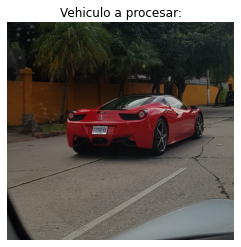


Tamaño de la imagen inicial: 1844x1925, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 711
top: 871
right: 864
bottom: 942

Visualización de placa detectada:


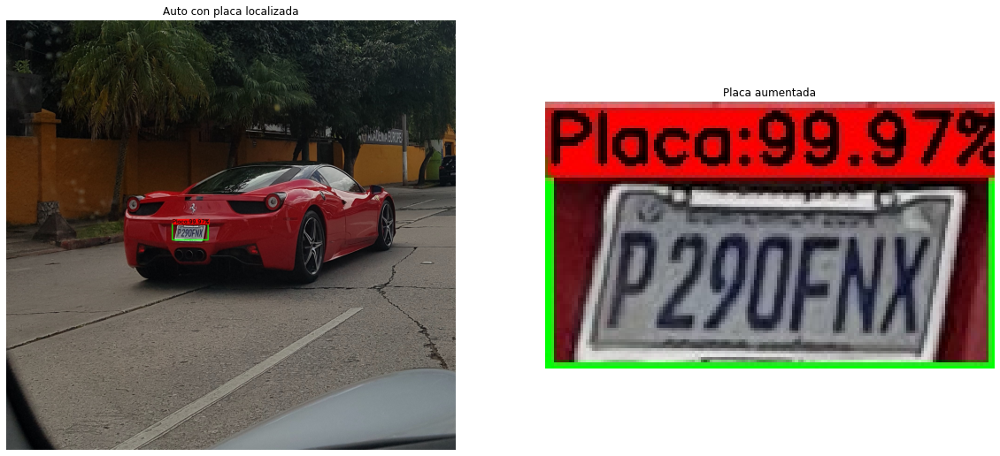


Segmentando Placa...


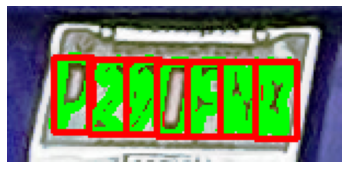

Extracción de caracteres:


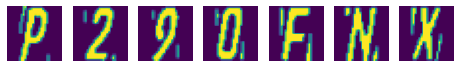

Prediciendo placa...


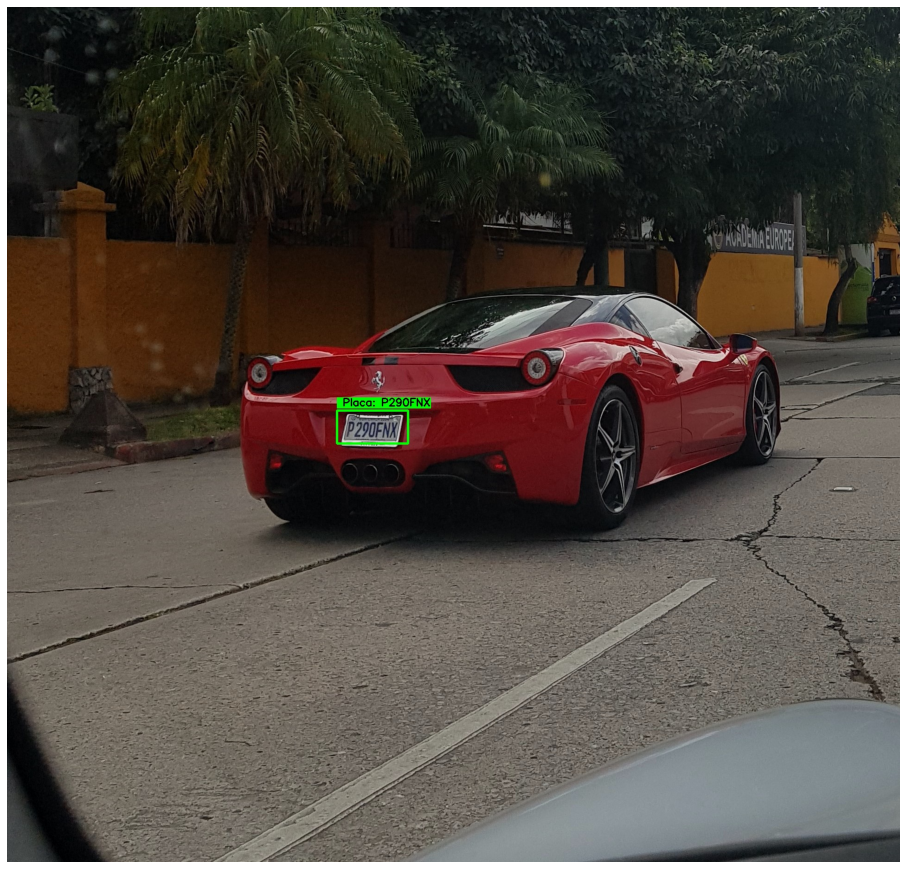

Aumentando placa con predicción...


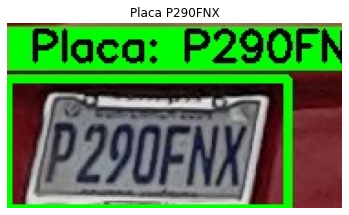

Terminado.


In [443]:
image2scan = "./auto18.jpg"
predict(image2scan, cnn_model_elastic)

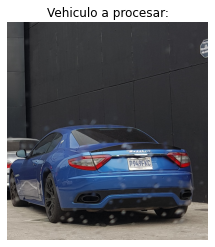


Tamaño de la imagen inicial: 1587x1465, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 882
top: 986
right: 1058
bottom: 1064

Visualización de placa detectada:


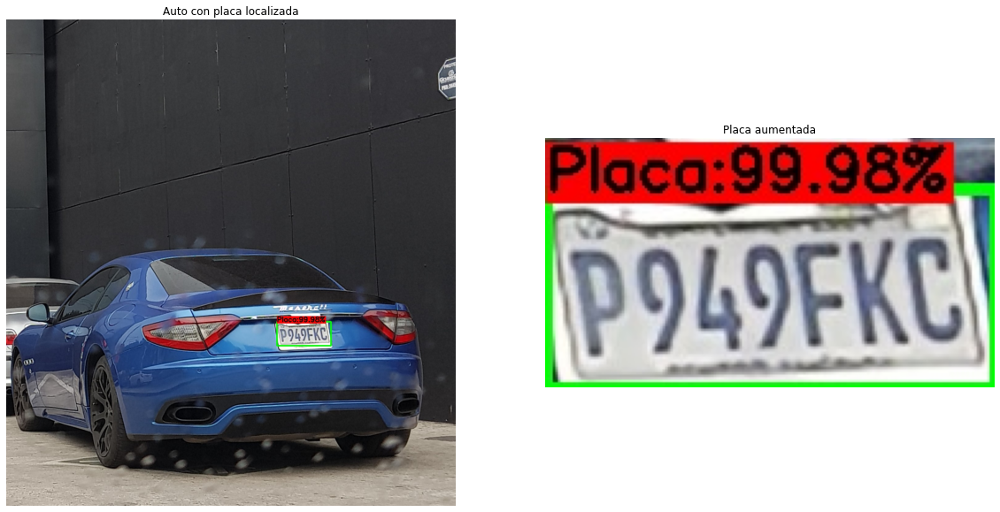


Segmentando Placa...


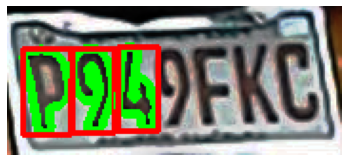


Segmentando Placa...


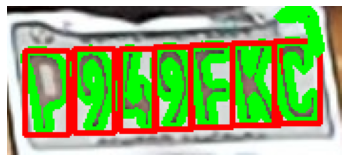

Extracción de caracteres:


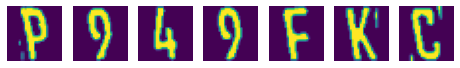

Prediciendo placa...


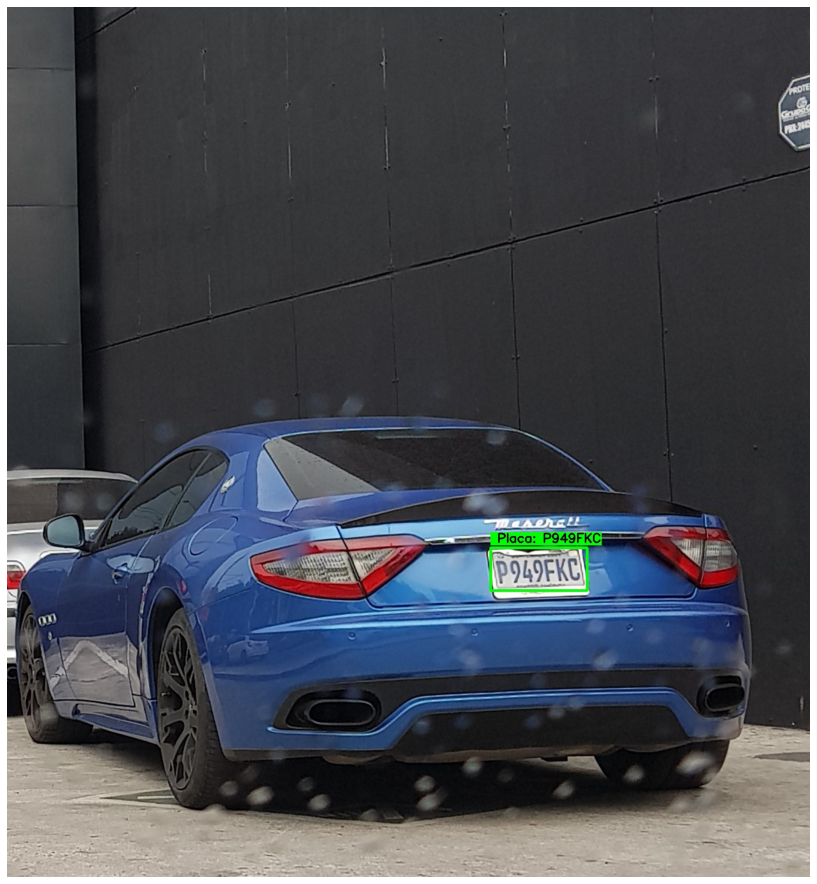

Aumentando placa con predicción...


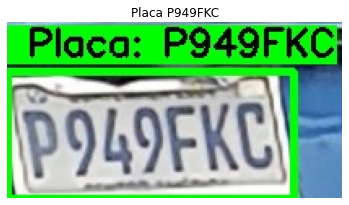

Terminado.


In [442]:
image2scan = "./auto11.jpg"
predict(image2scan, cnn_model_elastic)

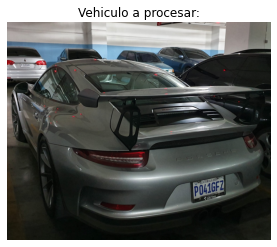


Tamaño de la imagen inicial: 2258x2732, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 1925
top: 1566
right: 2248
bottom: 1853

Visualización de placa detectada:


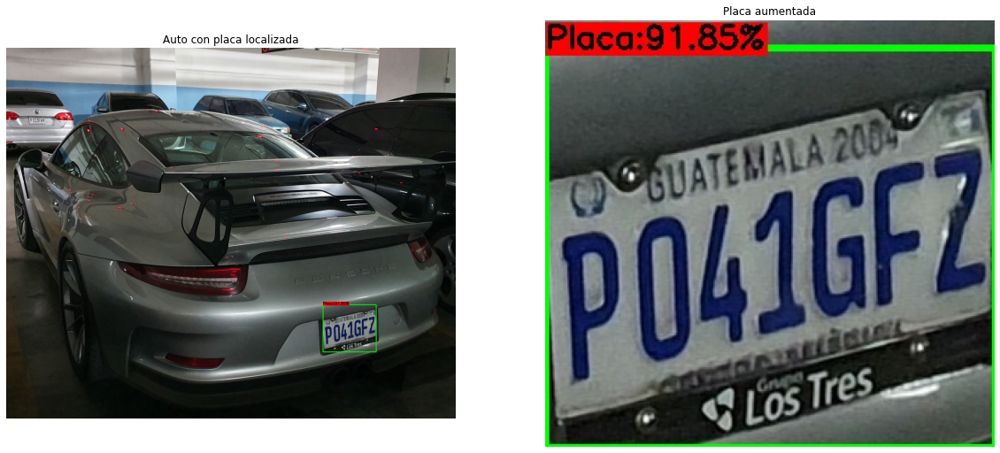


Segmentando Placa...


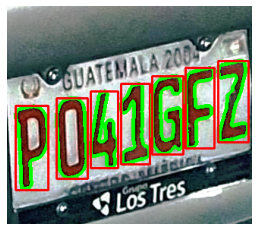

Extracción de caracteres:


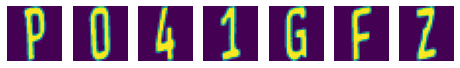

Prediciendo placa...


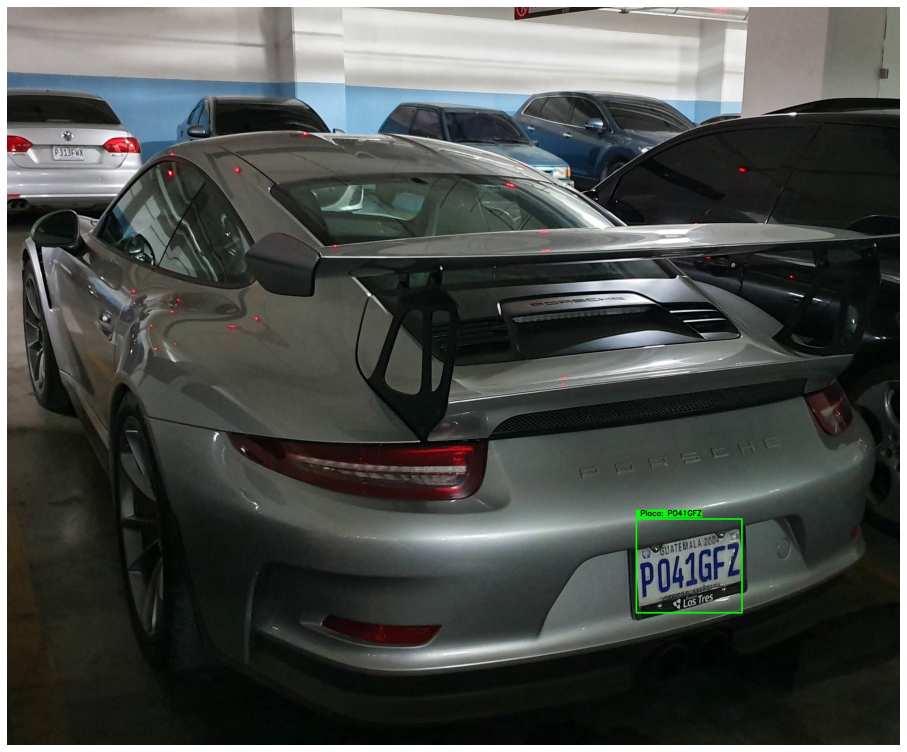

Aumentando placa con predicción...


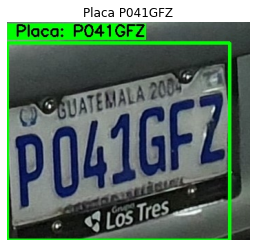

Terminado.


In [437]:
image2scan = "./auto2.jpg"
predict(image2scan, cnn_model_elastic)

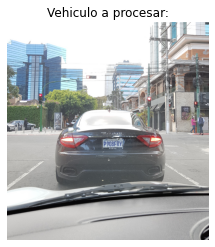


Tamaño de la imagen inicial: 2964x2741, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 1292
top: 1591
right: 1592
bottom: 1706

Visualización de placa detectada:


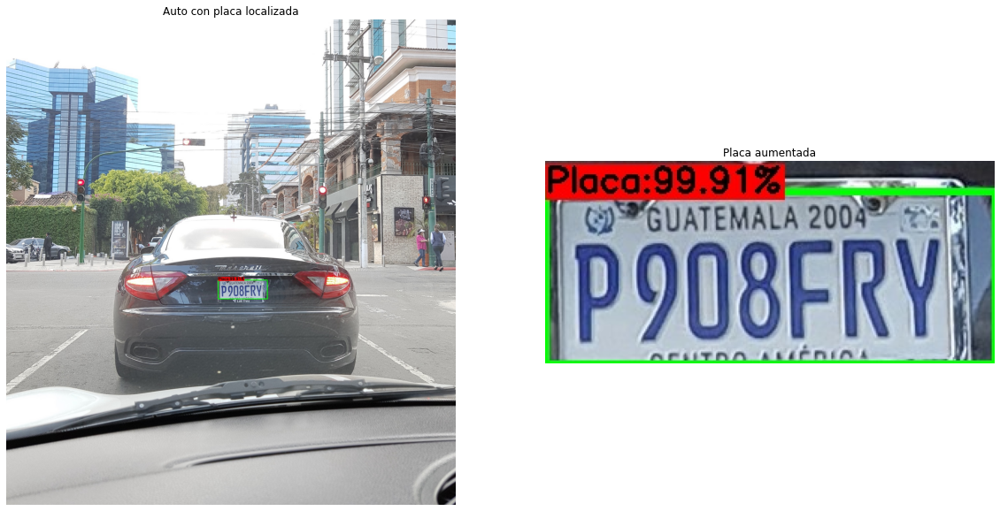


Segmentando Placa...


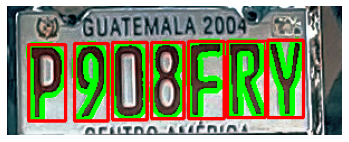

Extracción de caracteres:


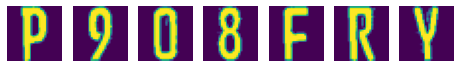

Prediciendo placa...


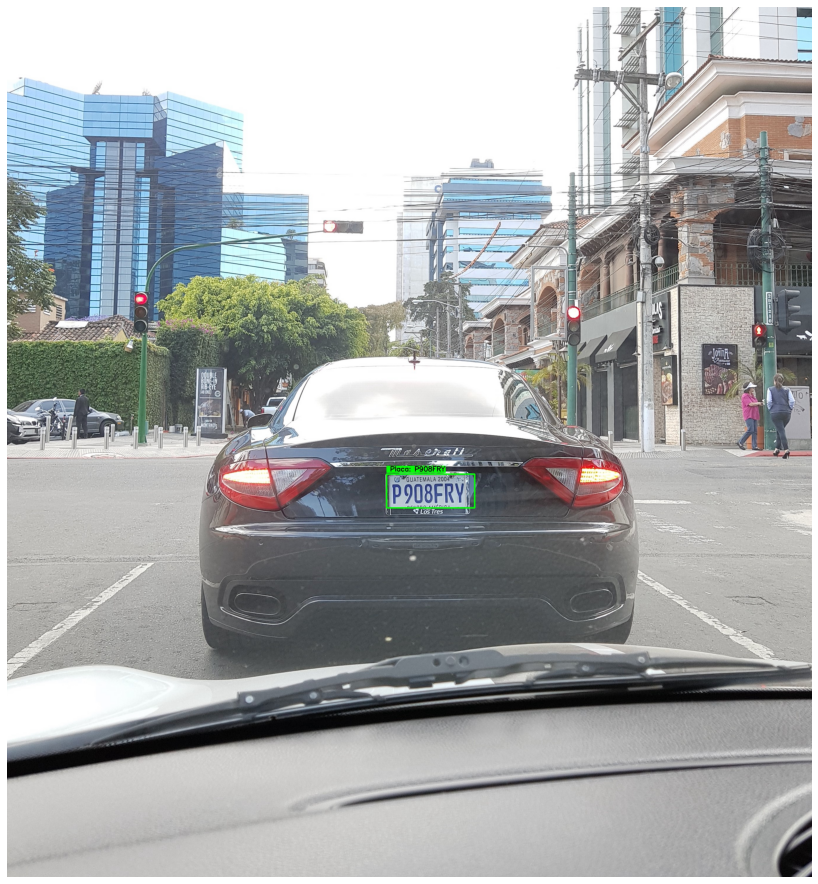

Aumentando placa con predicción...


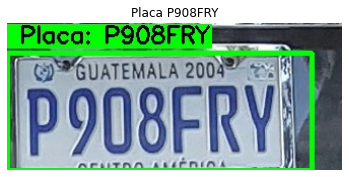

Terminado.


In [438]:
image2scan = "./auto13.jpg"
predict(image2scan, cnn_model_elastic)

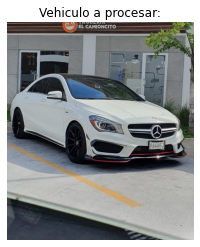


Tamaño de la imagen inicial: 1825x1564, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 1181
top: 993
right: 1320
bottom: 1068

Visualización de placa detectada:


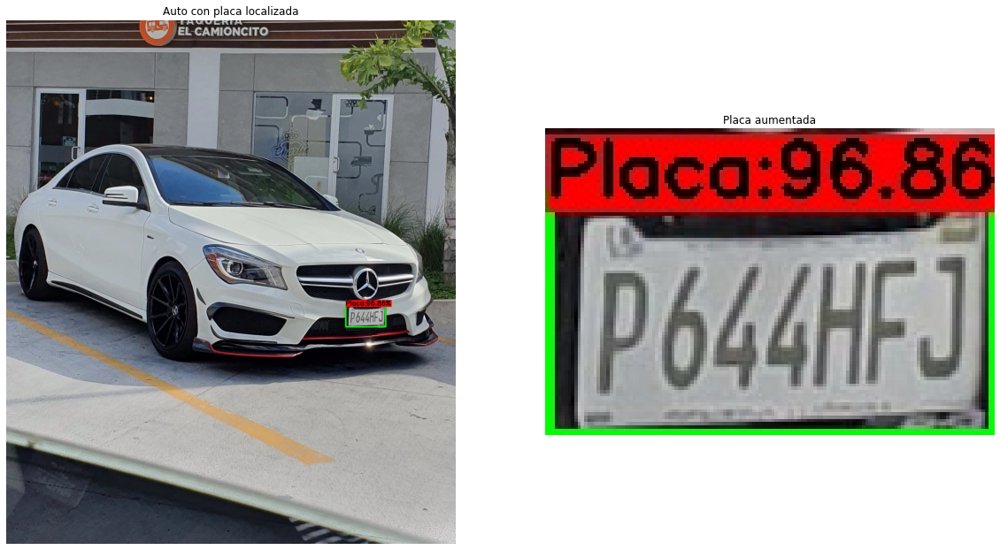


Segmentando Placa...


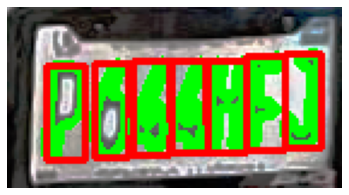

Extracción de caracteres:


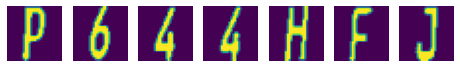

Prediciendo placa...


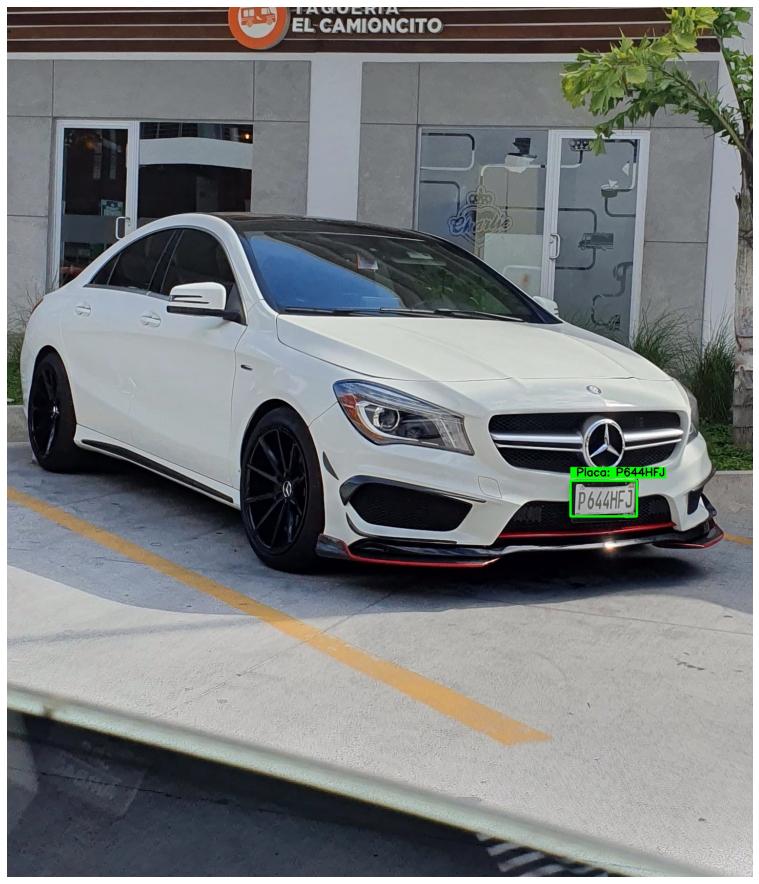

Aumentando placa con predicción...


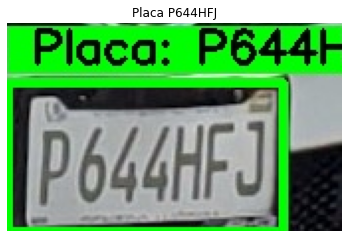

Terminado.


In [439]:
image2scan = "./auto22.jpg"
predict(image2scan, cnn_model_elastic)

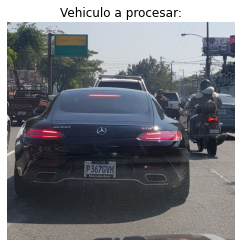


Tamaño de la imagen inicial: 2777x2902, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 997
top: 1767
right: 1366
bottom: 1966

Visualización de placa detectada:


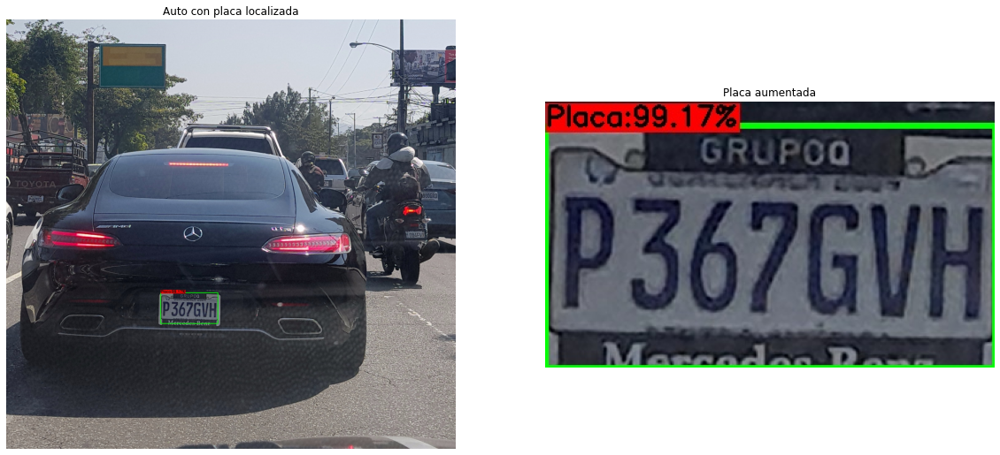


Segmentando Placa...


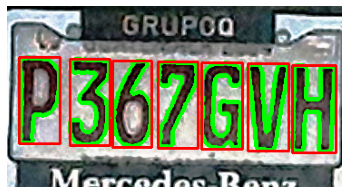

Extracción de caracteres:


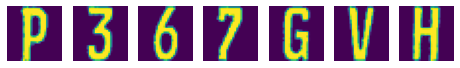

Prediciendo placa...


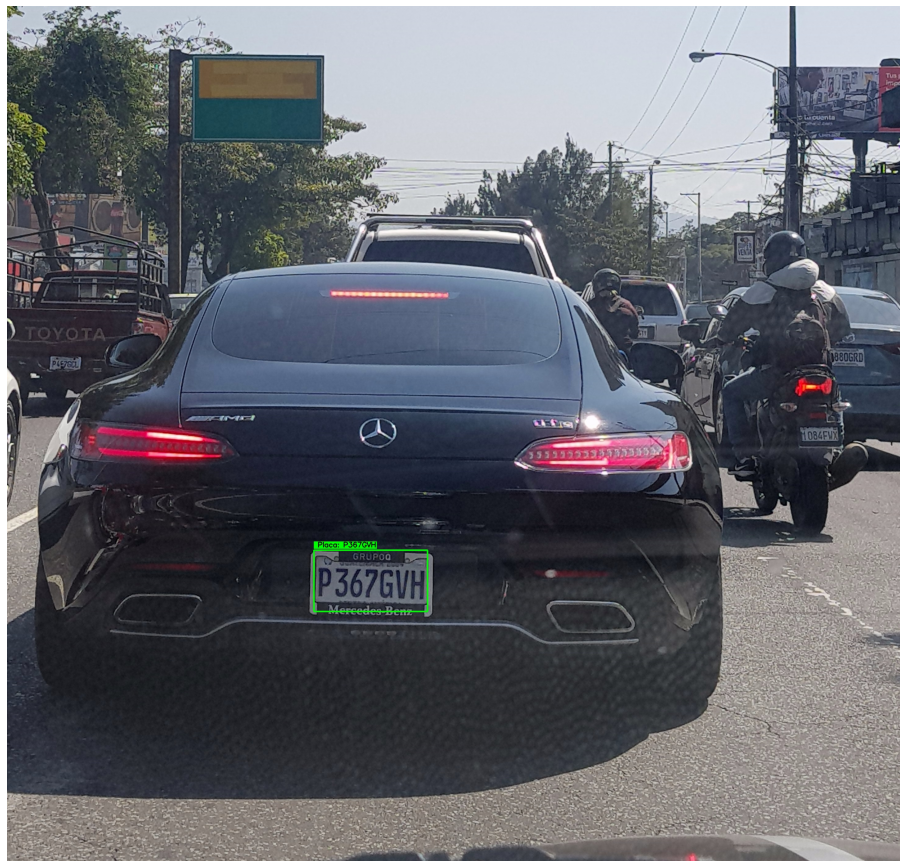

Aumentando placa con predicción...


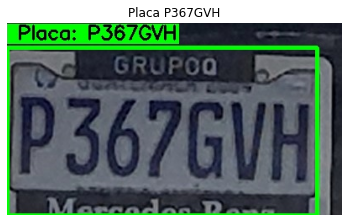

Terminado.


In [440]:
image2scan = "./auto16.jpg"
predict(image2scan, cnn_model_elastic)

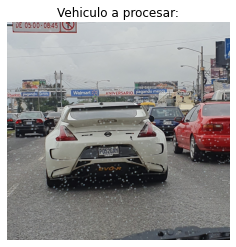


Tamaño de la imagen inicial: 1473x1505, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 616
top: 842
right: 752
bottom: 899

Visualización de placa detectada:


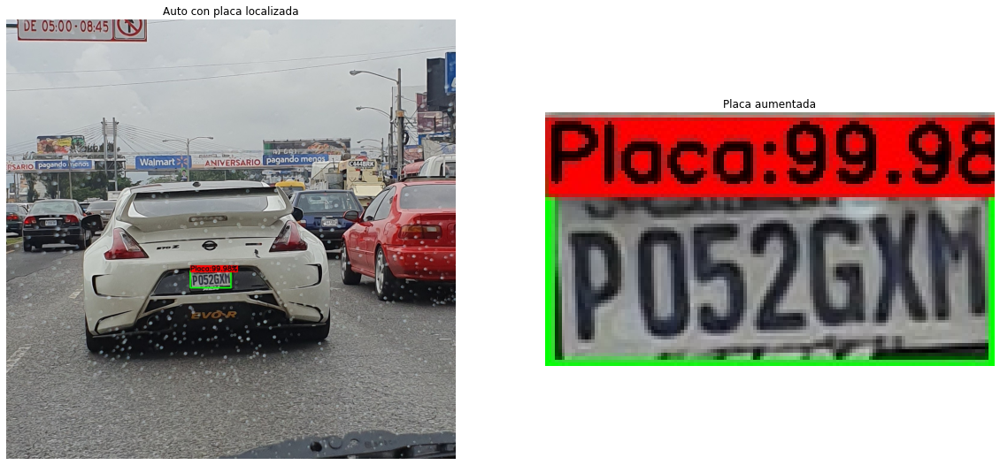


Segmentando Placa...


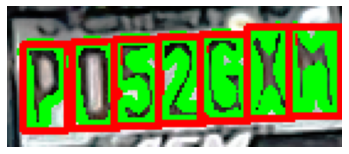

Extracción de caracteres:


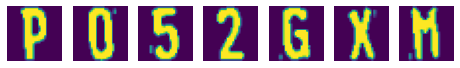

Prediciendo placa...


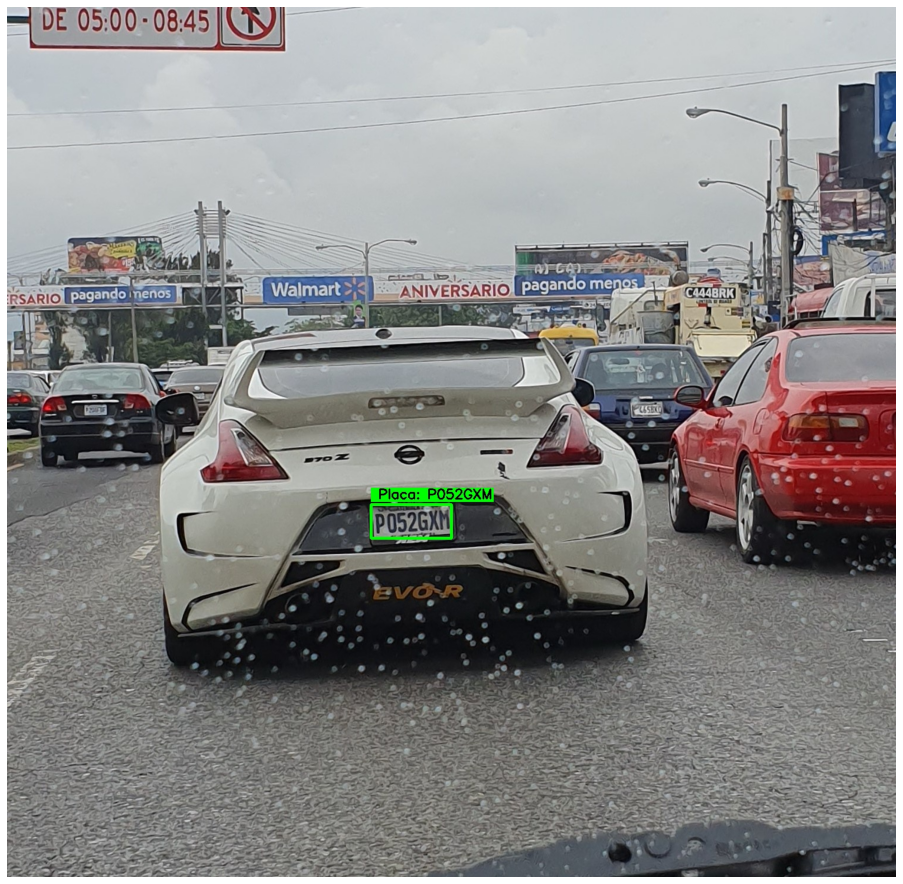

Aumentando placa con predicción...


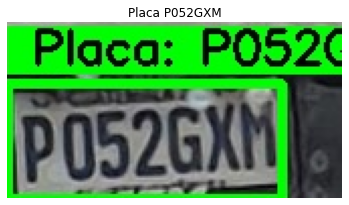

Terminado.


In [441]:
image2scan = "./auto36.jpg"
predict(image2scan, cnn_model_elastic)

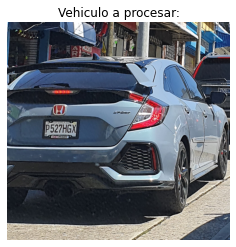


Tamaño de la imagen inicial: 1551x1587, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 258
top: 692
right: 504
bottom: 816

Visualización de placa detectada:


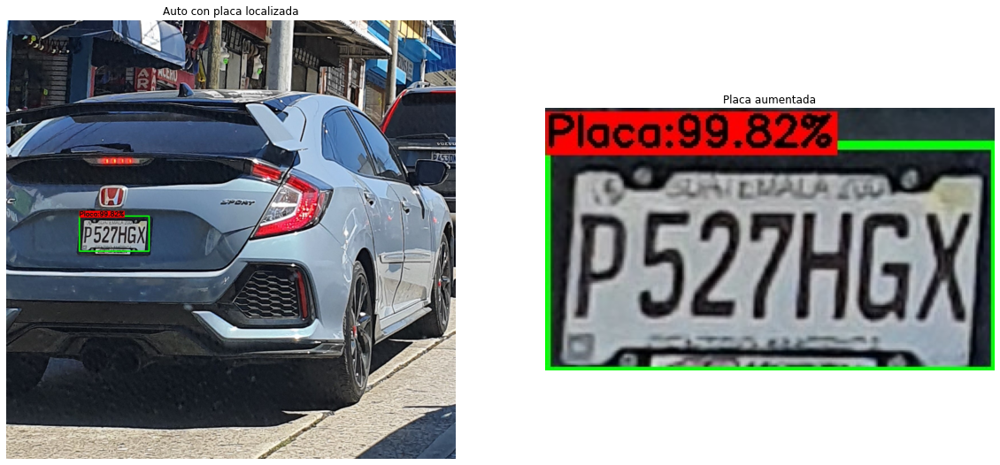


Segmentando Placa...


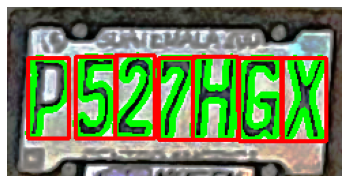

Extracción de caracteres:


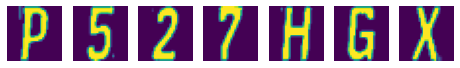

Prediciendo placa...


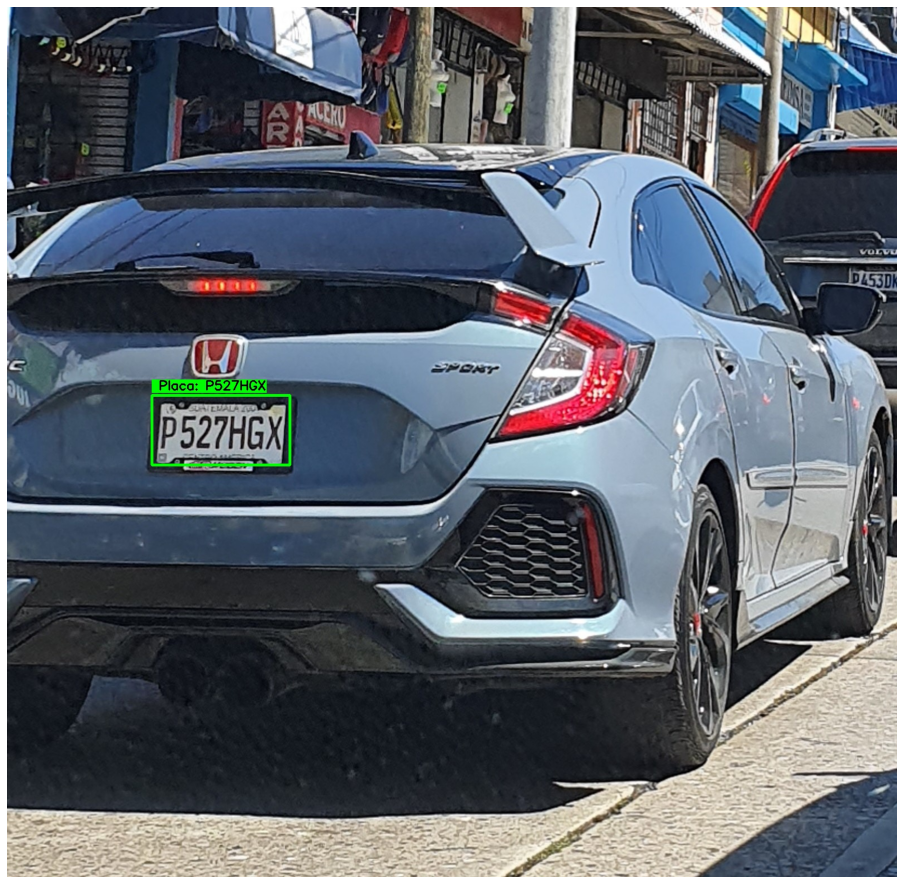

Aumentando placa con predicción...


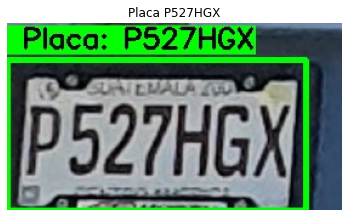

Terminado.


In [447]:
image2scan = "./auto8.jpg"
predict(image2scan, cnn_model_elastic)

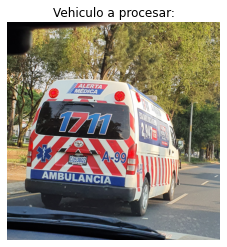


Tamaño de la imagen inicial: 1488x1457, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 419
top: 909
right: 553
bottom: 965

Visualización de placa detectada:


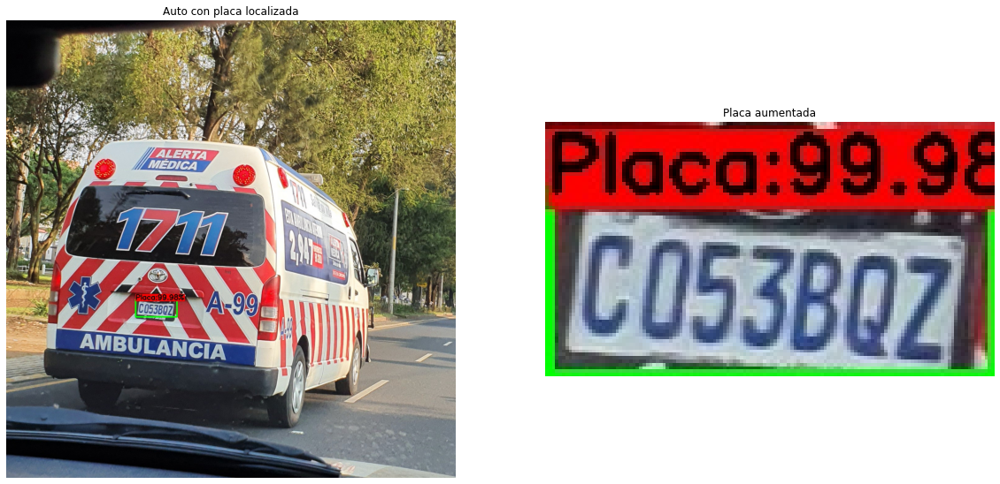


Segmentando Placa...


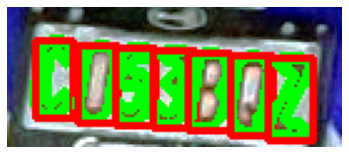

Extracción de caracteres:


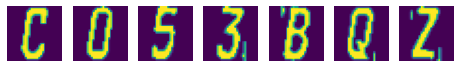

Prediciendo placa...


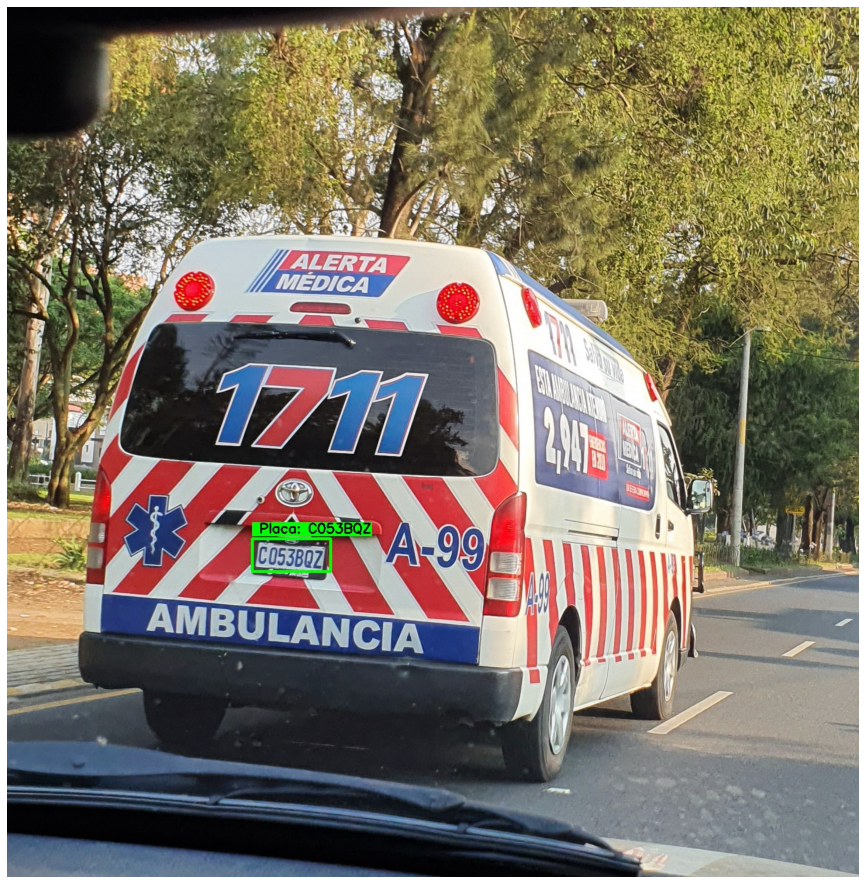

Aumentando placa con predicción...


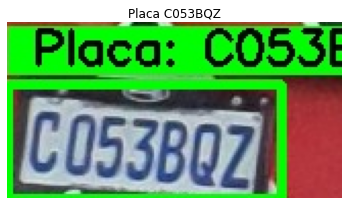

Terminado.


In [436]:
image2scan = "./auto25.jpg"
predict(image2scan, cnn_model_elastic)

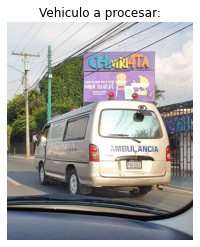


Tamaño de la imagen inicial: 2110x1803, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 1156
top: 1338
right: 1314
bottom: 1423

Visualización de placa detectada:


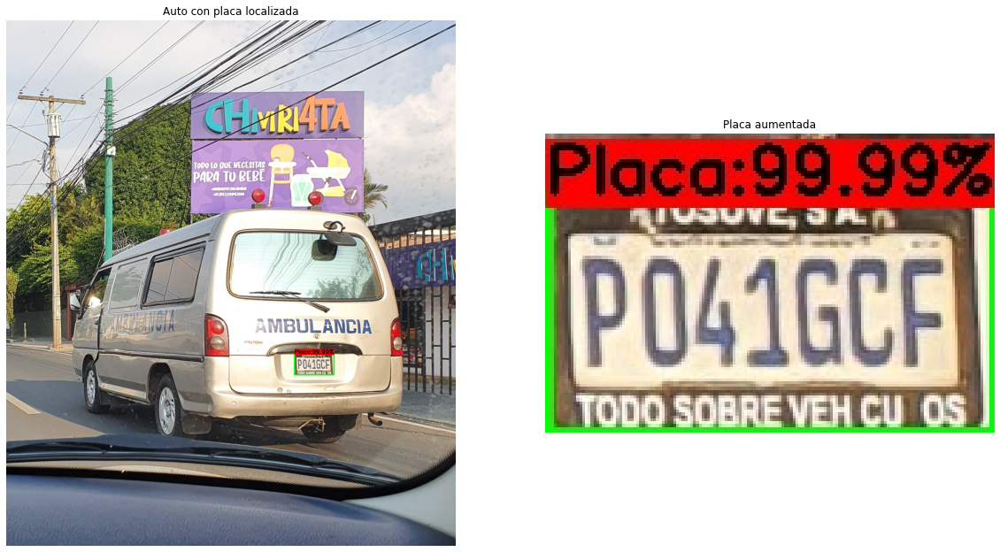


Segmentando Placa...


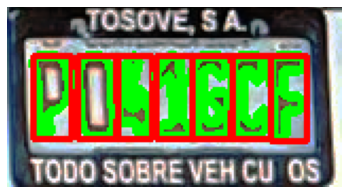

Extracción de caracteres:


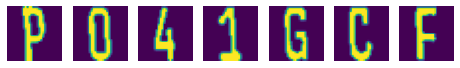

Prediciendo placa...


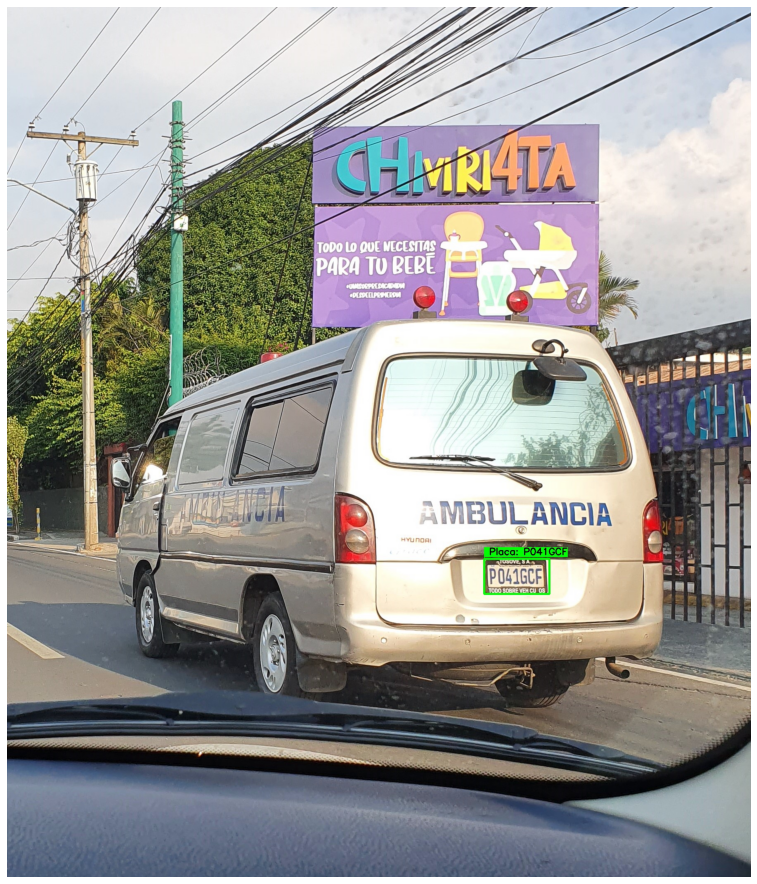

Aumentando placa con predicción...


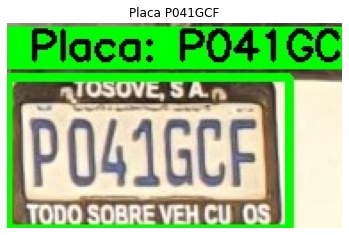

Terminado.


In [448]:
image2scan = "./auto28.jpg"
predict(image2scan, cnn_model_elastic)

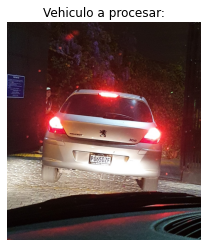


Tamaño de la imagen inicial: 1426x1270, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 538
top: 862
right: 688
bottom: 932

Visualización de placa detectada:


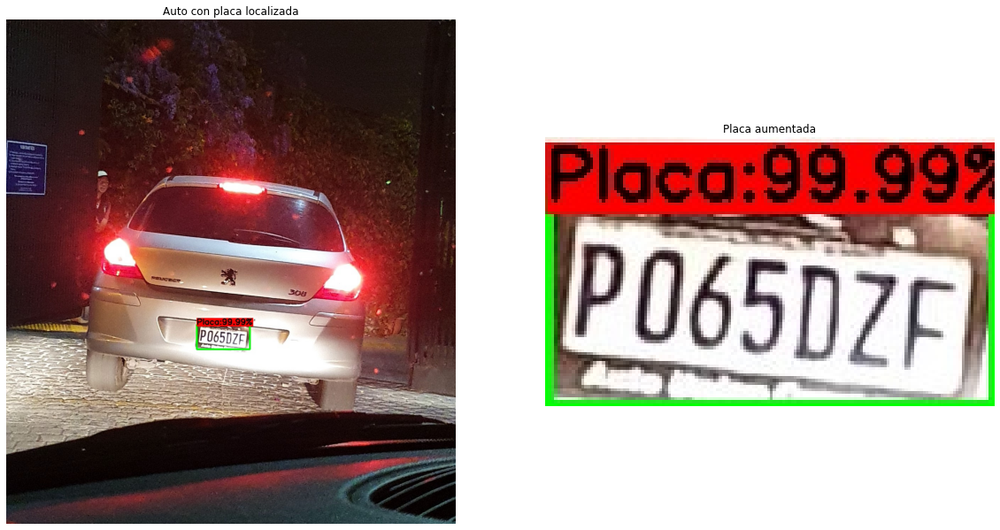


Segmentando Placa...


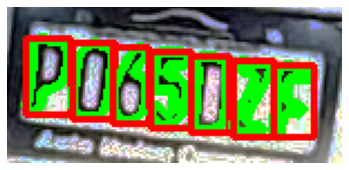

Extracción de caracteres:


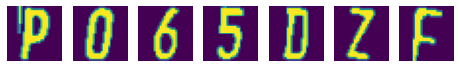

Prediciendo placa...


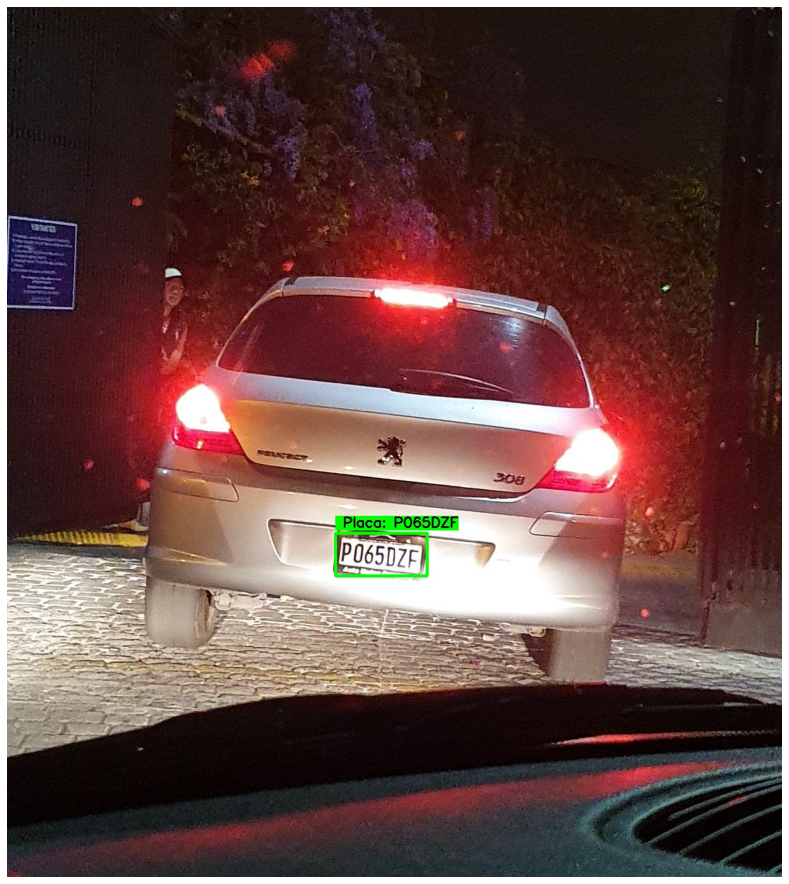

Aumentando placa con predicción...


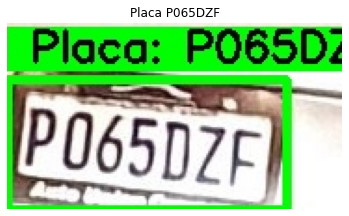

Terminado.


In [390]:
image2scan = "./auto33.jpg"
predict(image2scan, cnn_model_elastic)

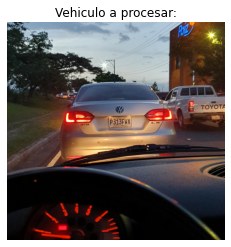


Tamaño de la imagen inicial: 2208x2207, 3 canales de color
Convirtiendo imagen a tamaño fijo de 416x416

Identificando placa...

Placa identificada con coordenadas: 
left: 1033
top: 962
right: 1250
bottom: 1050

Visualización de placa detectada:


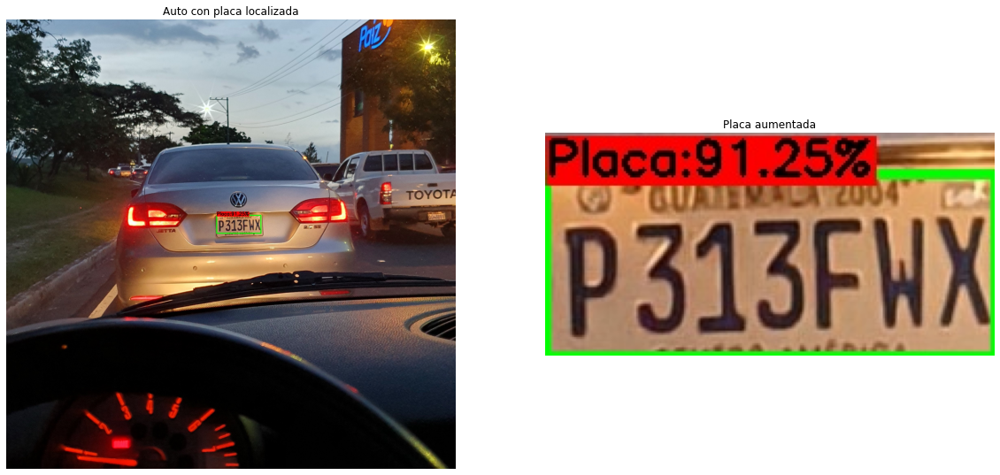


Segmentando Placa...


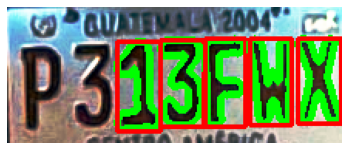


Segmentando Placa...


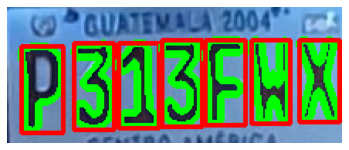

Extracción de caracteres:


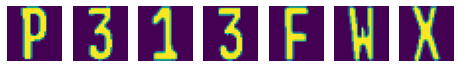

Prediciendo placa...


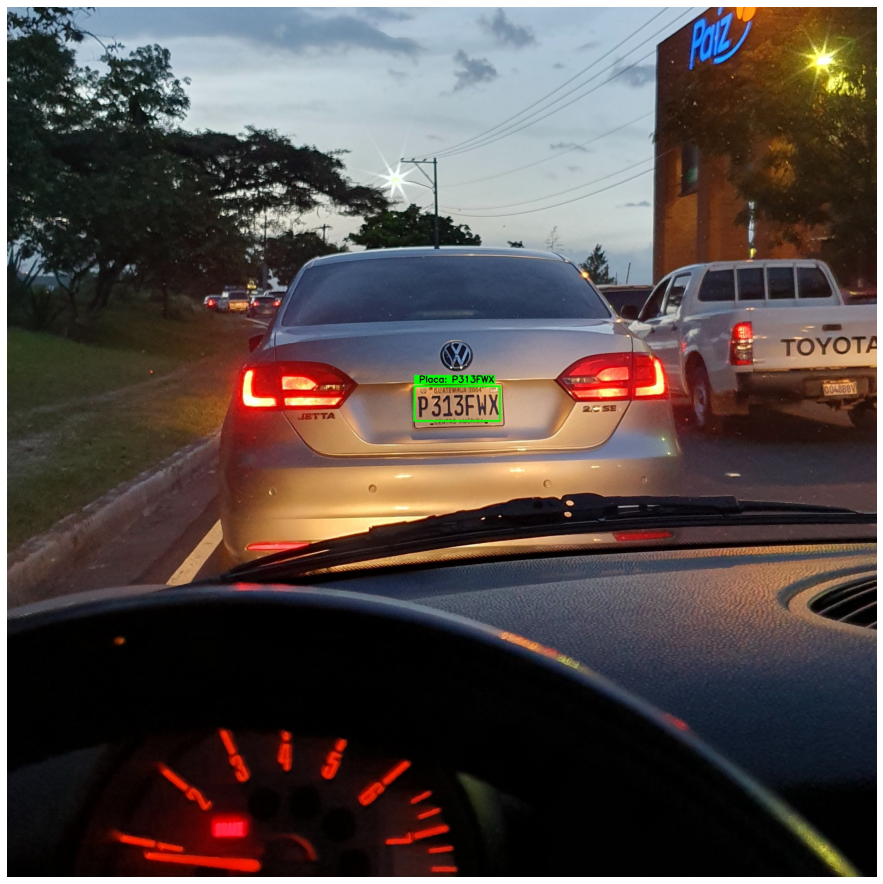

Aumentando placa con predicción...


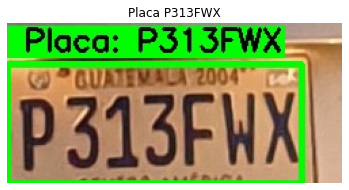

Terminado.


In [445]:
image2scan='auto12.jpg'
predict(image2scan, cnn_model_elastic)